<center> <h1> Deep Learning Project </h1>
    <h2> Sports Image Classification </h2> 
<center>

**Team:**
* Getinet Gawo
* Paul Minninger


### Problem Statement
* Our problem is to create a series of supervised image classification models using pretrained convolutional neural networks and homegrown models. Upon completion of each models optimization, we will create a user input system or Streamlit interface where a user can upload a given sport image and receive back the top 3 predicted classes from all 4 models. For example, an image could be submitted, and a single model would return that it is 90% confident it is Figure Skating Men, 9% Figure Skating Women and 1% Figure Skating Pairs. Each other model would provide the same outputs. This interactive piece differentiates our project from other applications.
    
    
    
* **Keywords:** Sports, image classiication, convolulitonal neural networks, pretrained models
	

### Data Collection
* Source(url): https://www.kaggle.com/gpiosenka/sports-classification
* Short Description : The dataset contains images of 73 different sports in jpg format with 10k train images and 365 validation and test images each

* Keywords: Sports images, sports, image classifcation, deep learning, CNNs

### Required packages

* Tensorflow
* Keras
* Timeit
* Os
* Keras optimizers
* Keras Preprocessing - ImageDataGenerator
* Keras Dense, GlobalMaxPooling2D, GlobalAveragePooling2D, MaxPooling2D, Conv2D, Flatten, Dropout
* Keras Load Model
* Matplotlib
* Keras Preprocessing - Image
* Numpy
* PIL - Image, ImageOps
* Keras Callbacks - Early Stopping
* SciKit Learn
* Scikit Learn - Classification report, Confusion matrix
* Scikit Learn Metrics - Confusion Matrix Display
* Scikit Learn Preprocessing - LabelBinarizer
* Scikit Learn Metrics -  ROC curve, AUC, and ROC AUC Score
* MPL Toolkits Axes Grid 1 - Image Grid



In [1]:
#Import necessary packages to run all of the code

import tensorflow as tf
from tensorflow import keras
import timeit
import os
from tensorflow.keras import optimizers
from keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from keras.preprocessing import image
import numpy as np
import keras
from PIL import Image, ImageOps
from tensorflow.keras.callbacks import EarlyStopping
import sklearn
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc, roc_auc_score
from mpl_toolkits.axes_grid1 import ImageGrid
from mpl_toolkits.axes_grid1 import ImageGrid
from PIL import Image
from tensorflow.keras.layers import Dense, GlobalMaxPooling2D, GlobalAveragePooling2D, MaxPooling2D, Conv2D, Flatten, Dropout
from tensorflow.keras.models import load_model



### Loading and Preprocessing Images

#### Loading the images and  Generating Data from Images

In [ ]:
#save variables that dictate paths to the train, validation and test directories
train_dir = "../sport_classification_images/train"
test_dir = "../sport_classification_images/test"
valid_dir = "../sport_classification_images/valid"

In [32]:
#define variables for the images
img_height = 150
img_width = 150
img_shape = (img_height, img_width, 3)
batch_size = 32

#load data generators and rescale the images for train, test and validation
train_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0)

#create the generators and load the images from the directories
train_generator = train_data_gen.flow_from_directory(
    train_dir, 
    class_mode='categorical', 
    batch_size = batch_size)

test_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0)

test_generator = test_data_gen.flow_from_directory(
    test_dir, 
    class_mode='categorical', 
    batch_size = batch_size)

valid_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0)

valid_generator = valid_data_gen.flow_from_directory(
    valid_dir, 
    class_mode ='categorical', 
    batch_size = batch_size)

Found 10416 images belonging to 73 classes.
Found 365 images belonging to 73 classes.
Found 365 images belonging to 73 classes.


In [33]:
#print the train, test and validate directories
print("The training folder has ", len(os.listdir(train_dir)), "directories.")
print("The testing folder has ", len(os.listdir(test_dir)), "directories.")
print("The validating folder has ", len(os.listdir(valid_dir)), "directories.")

The training folder has  73 directories.
The testing folder has  73 directories.
The validating folder has  73 directories.


In [34]:
# Get all subdirectories
class_labels = os.listdir(train_dir) 
# Dictionary used to hold the sport name and the corresponding number of images
sport_num_images = {}

# Loop over each subdirectory (sport name) and get the number of images in that subdirectory.
for f in class_labels:
    num_images = len(os.listdir(train_dir + "/" + f)) # number of images in a subdirectory
    sport_num_images[f] = num_images

print(sport_num_images)

{'lacrosse': 151, 'arm wrestling': 99, 'golf': 157, 'surfing': 142, 'snow boarding': 117, 'parallel bar': 133, 'giant slalom': 151, 'bobsled': 138, 'weightlifting': 134, 'barell racing': 123, 'uneven bars': 158, 'pole vault': 138, 'rowing': 143, 'air hockey': 112, 'shot put': 155, 'field hockey': 158, 'harness racing': 147, 'canoe slamon': 164, 'football': 191, 'ski jumping': 130, 'cricket': 130, 'figure skating women': 159, 'horse racing': 139, 'baseball': 174, 'billiards': 145, 'bowling': 120, 'motorcycle racing': 132, 'javelin': 136, 'bull riding': 149, 'sumo wrestling': 133, 'tug of war': 128, 'figure skating men': 146, 'sailboat racing': 144, 'horse jumping': 137, 'basketball': 169, 'frisbee': 133, 'high jump': 159, 'water polo': 130, 'polo': 157, 'rock climbing': 141, 'rollerblade racing': 159, 'figure skating pairs': 151, 'balance beam': 152, 'formula 1 racing': 191, 'volleyball': 147, 'croquet': 136, 'table tennis': 141, 'rugby': 166, 'fencing': 135, 'ampute football': 112, 'na

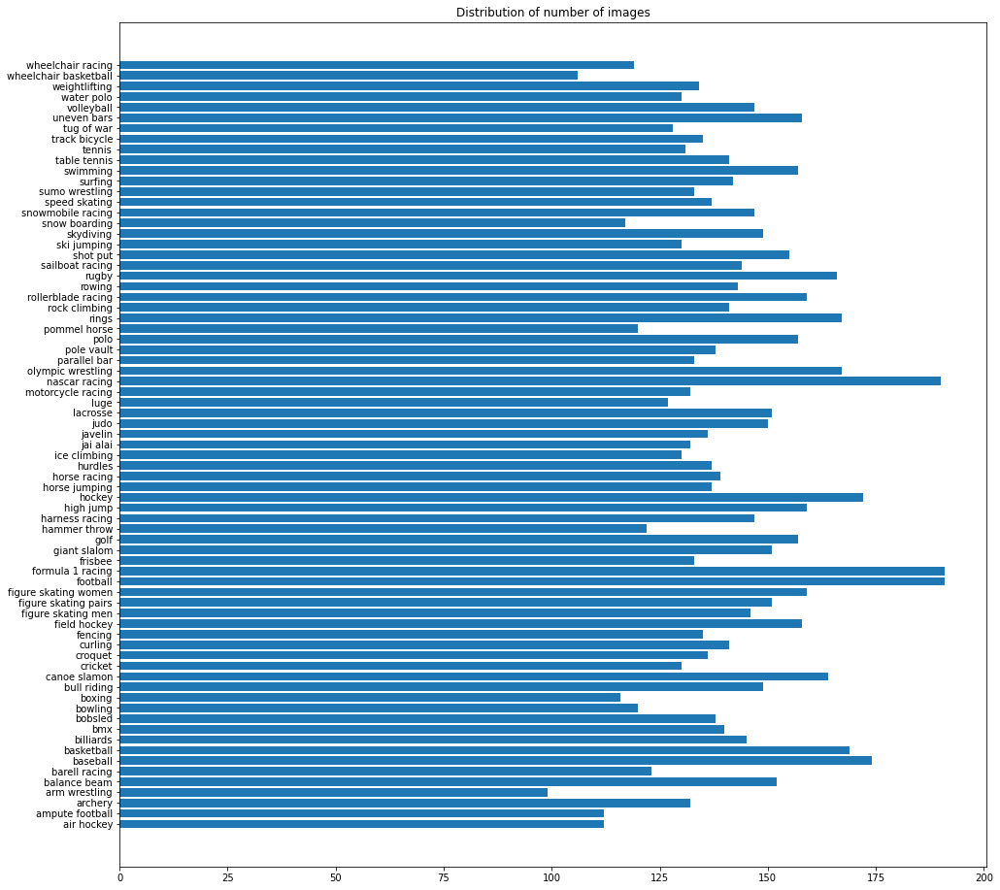

In [35]:
# Displaying ditribution of the number of images 

sports = list(train_generator.class_indices.keys())
sport_counts = []

for s in sports:
    sport_counts.append(len(os.listdir(f"{train_dir}/{s}")))
    
plt.figure(figsize=(16, 16))
plt.barh(sports,sport_counts)
plt.title("Distribution of number of images")
plt.show()

#### Inspecting the Original Images
From the images as well as the report, one can see that the original images have size of 256x256 pixels.

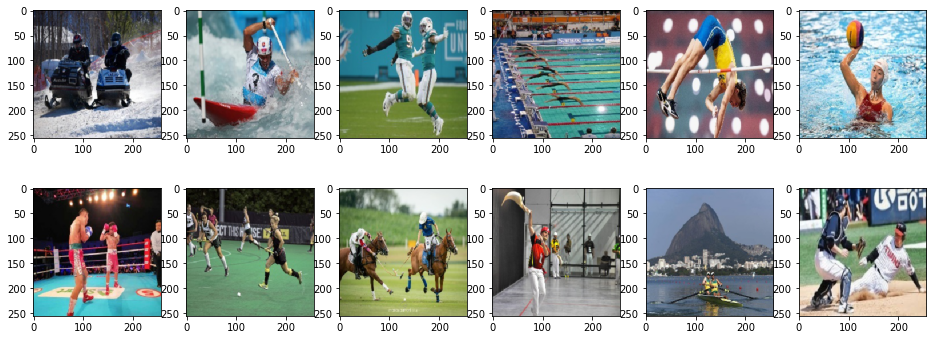

In [36]:
# Showing images before they get resized. In the plot observe that the images
# have size of 256x256 pixels.
k=1
plt.figure(figsize=(16, 6))
for i in tf.random.uniform(shape=[12], minval=0, maxval=20, dtype=tf.int32):
    plt.subplot(2,6,k)
    plt.imshow(train_generator.next()[0][i][0:][0:])
    k+=1
plt.savefig("ImagesBefore.jpg", )
plt.show()

In [37]:
def review_generator(img_type):
    for data_batch, labels_batch in img_type:
        print('Original data batch shape:', data_batch.shape)
        print('Original labels batch shape:', labels_batch.shape)
        break
print("The size of images before they get resized.\n===========================================") 
print("Review of training generator: ")
review_generator(train_generator)
print("===========================================")
print("Review of testing generator: ")
review_generator(test_generator)
print("==========================================")
print("Review of validation generator: ")
review_generator(valid_generator)
print("===========================================")


The size of images before they get resized.
Review of training generator: 
Original data batch shape: (32, 256, 256, 3)
Original labels batch shape: (32, 73)
Review of testing generator: 
Original data batch shape: (32, 256, 256, 3)
Original labels batch shape: (32, 73)
Review of validation generator: 
Original data batch shape: (32, 256, 256, 3)
Original labels batch shape: (32, 73)


### Image Processing

In [38]:
#### Resizing images and Image Augmentation

In [39]:
# Resizin images: All images are resized to 150x150 pixels.
# Training images are augmented
img_height = 150
img_width = 150
img_shape = (img_height, img_width, 3)
batch_size = 64

train_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0,
    rotation_range=20,  # Image augmentation
   width_shift_range=0.2, 
    height_shift_range=0.2, 
    shear_range=20, 
    zoom_range=0.5, 
    horizontal_flip=True,
    vertical_flip=True, 
 fill_mode = "nearest")

train_generator = train_data_gen.flow_from_directory(
    train_dir, 
    class_mode='categorical', 
    batch_size = batch_size, 
    target_size = (img_height, img_width),
    shuffle = True)

test_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0)
test_generator = test_data_gen.flow_from_directory(
    test_dir, 
    class_mode='categorical', 
    batch_size = batch_size, 
    target_size = (img_height, img_width),
    shuffle = False)

valid_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0)
valid_generator = valid_data_gen.flow_from_directory(
    valid_dir, 
    class_mode ='categorical', 
    batch_size = batch_size, 
    target_size = (img_height, img_width),
    shuffle = False)

Found 10416 images belonging to 73 classes.
Found 365 images belonging to 73 classes.
Found 365 images belonging to 73 classes.


In [40]:
def review_generator(img_type):
    for data_batch, labels_batch in img_type:
        print('Original data batch shape:', data_batch.shape)
        print('Original labels batch shape:', labels_batch.shape)
        break
print("The size of images after they get resized.\n===========================================") 
print("Review of training generator: ")
review_generator(train_generator)
print("===========================================")
print("Review of testing generator: ")
review_generator(test_generator)
print("==========================================")
print("Review of validation generator: ")
review_generator(valid_generator)
print("===========================================")


The size of images after they get resized.
Review of training generator: 
Original data batch shape: (64, 150, 150, 3)
Original labels batch shape: (64, 73)
Review of testing generator: 
Original data batch shape: (64, 150, 150, 3)
Original labels batch shape: (64, 73)
Review of validation generator: 
Original data batch shape: (64, 150, 150, 3)
Original labels batch shape: (64, 73)


In [41]:
#Batch Size function as each model uses a different batch size

def batch_size(batch_size):# Resizin images: All images are resized to 150x150 pixels.
# Training images are augmented

    train_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0,
        rotation_range=20,  # Image augmentation
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        shear_range=20, 
        zoom_range=0.5, 
        horizontal_flip=True,
        vertical_flip=True, 
         fill_mode = "nearest")

    train_generator = train_data_gen.flow_from_directory(
        train_dir, 
        class_mode='categorical', 
        batch_size = batch_size, 
        target_size = (img_height, img_width),
        shuffle = True)

    test_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0)
    test_generator = test_data_gen.flow_from_directory(
        test_dir, 
        class_mode='categorical', 
        batch_size = batch_size, 
        target_size = (img_height, img_width),
        shuffle = False)

    valid_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0)
    valid_generator = valid_data_gen.flow_from_directory(
        valid_dir, 
        class_mode ='categorical', 
        batch_size = batch_size, 
        target_size = (img_height, img_width),
        shuffle = False)
    
    return train_generator, test_generator, valid_generator

#### Insepecting Processed Images
Note that the size of images has reduced to 150x150 pixels. Moreover, we can see the applied augumentations in the images, vertical flips, shear, zoom etc.

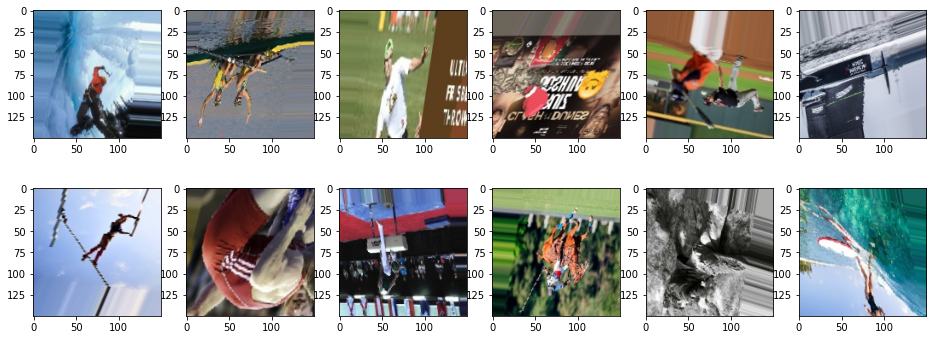

In [42]:
#Plot the resized images
k=1
plt.figure(figsize=(16, 6))
for i in tf.random.uniform(shape=[12], minval=0, maxval=20, dtype=tf.int32):
    plt.subplot(2,6,k)
    plt.imshow(train_generator.next()[0][i][0:][0:])
    k+=1
plt.savefig("ImagesAfter_augmentation.jpg", )
plt.show()

### Methodology

1. Deep Learning process / methodology

In this project we build neural network models from scratch as well as transfer learnings from pre-built cutting edge neural networks. We build a convolutional neural network-based architecture from scratch. We transferred learnings from neural networks VGG19, MobileNetV2 and InceptionV3. 


2. Deep Neural Networks used:


 * Pretrained VGG19 CNN Model 
 
   The VGG19 CCN was extended with addition on output layer of 73 nodes with softmax actiavtion function. The model was compiled with the learning rate of 1e-1 and Adam optimizer. The model run for 200 epochs.
 
 
 * Pretrained MobileNetV2 CNN Model
 
    MobileNetV2 has a low parameter count which is advantageous given the training requied for the dataset. Keras states that “MobileNetV2 is very similar to the original MobileNet, except that it uses inverted residual blocks with bottlenecking features. The MobileNetV2 model has two dense layers and a droput layer.
 
 
 * Pretrained InceptionV3 CNN Model
 
    InceptionV3 is composed of convolutions, average pooling, max pooling, concats, dropouts and fully connected layers (Google Cloud, 2021). InceptionV3 has a moderate parameter count in comparison to all transfer learning models available. The model contains two dense layers.
    
    
 * Custom CNN Model
 
    The Custom Model is created from scratch. The parameters and layers used to create the model are detailed below.
   
   
**Keywords:** image classification, multi-label classification, transfer learning, prediction,Convolutional Neural Network

### Model Fitting and Validation

1. Model Pretrained with VGG19
    - Total Parameters - Total: 23,051,913; Trainable params: 3,027,529; Non-trainable params: 20,024,384
    - Dense Layers - 1 with 73 nodes
    - Optimizer - Adam
    - Learning Rate - 1e-1
    - Loss Function - Categorical Crossentropy
    - Metrics - Accuracy
    - Epochs - 200
    - Batch Size - 64


2. Custom CNN Model
    - Total Parameters - Total: 7,922,441 
    - Convolutional Layers 7
    - MaxPooling(2, 2) - 3
    - Dense Layers - 1 with 73 nodes
    - Optimizer - Adam
    - Learining Rate - 1e-5
    - Loss Function - Categorical Crossentropy
    - Metrics - Accuracy
    - Epochs - 100
    - Batch Size - 256

3. Model Pretrained with MobileNetV2
    - Total Parameters - Total: 2, 988, 937; Trainable Parms:730, 953; Non-trainable Params 2,257,984
    - Dense Layers  - 2 with 1 dropout = 0.5
    - Optimizer - Adam
    - Learining Rate - 1e-4
    - Loss Function - Categorical Crossentropy
    - Metrics - Accuracy
    - Epochs - 34
    - Batch Size - 20

4. Model Pretrained with InceptionV3
    - Total Parameters - Total: 22,926,953; Trainable: 1,124,169; Non-trainable: 21,802,784
    - Dense Layers  - 2 - Output with 73 nodes
    - Optimizer - Adam
    - Learining Rate - 1e-4
    - Loss Function - Categorical Crossentropy
    - Metrics - Accuracy
    - Epochs - 20
    - Batch Size - 20

### Utility Function

In [ ]:
# Defining a function that plots the accuracy and the loss. This function could be used later.
def acc_loss_plotter(history, model_name):
    
    plt.figure(figsize = (12, 4))
    
    #Store the performance metrics from the model fit including loss and accuracy
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    #Define the x axis as the number of epochs
    epochs = range(len(acc))

    #Plot the accuracy of the training and validation tests
    plt.subplot(1,2, 1)
    plt.plot(epochs, acc, 'g', label='Training acc')
    plt.plot(epochs, val_acc, 'b', label='Validation acc')
    plt.xlabel("Epochs")
    plt.title('Training and validation accuracy - ' + model_name)
    plt.legend()


    #Plot the loss of the training and validation tests
    plt.subplot(1,2, 2)
    plt.plot(epochs, loss, 'orange', label='Training loss')
    plt.plot(epochs, val_loss, 'r', label='Validation loss')
    plt.xlabel("Epochs")
    plt.title('Training and validation loss - ' + model_name)
    plt.legend()

    plt.show()

### VGG16 Model

In [11]:
# Returning train test and validation generator based on the batch size using predefined function.
train_generator, test_generator, valid_generator = batch_size(64)

Found 10416 images belonging to 73 classes.
Found 365 images belonging to 73 classes.
Found 365 images belonging to 73 classes.


In [13]:
# VGG19 Base model
vgg = tf.keras.applications.VGG19(input_shape=img_shape, include_top=False, weights="imagenet")

# We will make the layers from VGG nontraininbale. Because we don't want  them to be trained again.
for layer in vgg.layers:
    layer.trainable = False

vgg_model = tf.keras.models.Sequential()
for layer in vgg.layers[0:-1]:
    vgg_model.add(layer)

vgg_model.add(tf.keras.layers.Flatten())
vgg_model.add(tf.keras.layers.Dense(73, activation='softmax'))

vgg_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 150, 150, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 150, 150, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 75, 75, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 75, 75, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 75, 75, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 37, 37, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (None, 37, 37, 256)       2

In [ ]:
# Compling the model
learning_rate = 1e-1
optim = tf.keras.optimizers.Adam(learning_rate = learning_rate)

vgg_model.compile(loss='categorical_crossentropy', 
              optimizer = optim, metrics= ['accuracy'])


# Training the model
epochs = 200
start_time = timeit.default_timer()

history = vgg_model.fit(train_generator, 
                            epochs = epochs, 
                              validation_data = valid_generator)

end_time = timeit.default_timer()
print("The time elapsed to train VGG19 model over {} epochs: {} seconds.". format(epochs, round(end_time-start_time,0))) 

In [ ]:
# Total time elapsed to train VGG19
print("The time elapsed to train VGG19 model over {} epochs: {} seconds.". format(epochs, round(end_time-start_time,0)))

In [ ]:
# Saving the VGG19 model
vgg_model.save("vgg_model.h5")

In [ ]:
acc_loss_plotter(history, "VGG19 Model")

### Custom Model

In [12]:
# Returning train test and validation generator based on the batch size using predefined function.
train_generator, test_generator, valid_generator = batch_size(256)

Found 10416 images belonging to 73 classes.
Found 365 images belonging to 73 classes.
Found 365 images belonging to 73 classes.


In [65]:

# CNN MODEL
custom_model = tf.keras.Sequential([
           tf.keras.layers.Conv2D(filters=64, kernel_size=(3, 3), activation='relu',
                        input_shape = img_shape),
            tf.keras.layers.Conv2D(64, (3, 3), activation='relu'), 
            tf.keras.layers.MaxPooling2D((2, 2)),
    
           tf.keras.layers.Conv2D(64, (3, 3), activation='relu'), 
           tf.keras.layers.Conv2D(64, (3, 3), activation='relu'), 
           tf.keras.layers.MaxPool2D((2,2)), 
    
           tf.keras.layers.Conv2D(128, (3, 3), activation='relu'), 
           tf.keras.layers.Conv2D(128, (3, 3), activation='relu'), 
           tf.keras.layers.MaxPool2D((2,2)), 
    
           tf.keras.layers.Conv2D(512, (3, 3), activation='relu'),                
          
           #Flatten the result
           tf.keras.layers.Flatten(),
           tf.keras.layers.Dense(73, activation='softmax')
                                  
])


In [22]:
# Viewing the network
custom_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 146, 146, 64)      36928     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 73, 73, 64)       0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 71, 71, 64)        36928     
                                                                 
 conv2d_3 (Conv2D)           (None, 69, 69, 64)        36928     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 34, 34, 64)       0         
 2D)                                                  

In [16]:
# define hyperparameters and compling the model
learning_rate = 1e-5
optim = tf.keras.optimizers.Adam(learning_rate = learning_rate)

custom_model.compile(loss='categorical_crossentropy', 
              optimizer = optim, metrics= ['accuracy'])

In [17]:
# Training the custom model
epochs = 100
start_time = timeit.default_timer()
history = custom_model.fit(train_generator, 
                            epochs = epochs, 
                              validation_data = valid_generator)
end_time = timeit.default_timer()
print("The time elapsed to train Custom model over {} epochs: {} seconds.". format(epochs, round(end_time-start_time,0))) 

('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [ ]:
# Saving the Custom model
custom_model.save("CNN_Custom_model.h5")

In [ ]:
acc_loss_plotter(history, "Custom Model")

### MobileNetV2

In [43]:
# Returning train test and validation generator based on the batch size using predefined function.
train_generator, test_generator, valid_generator = batch_size(20)

Found 10416 images belonging to 73 classes.
Found 365 images belonging to 73 classes.
Found 365 images belonging to 73 classes.


In [45]:
#Transfer learning is used so the knowledge of established models 
#This model utilizes the MobileNetV2 package
#The image shape is specified and the preestablished weights for the model are set
#include_top is false so that we can add our model dense layers after 


tl3_model = tf.keras.applications.MobileNetV2(weights='imagenet',  input_shape=(150, 150, 3),include_top=False)

#Weights are frozen so the pre trained model does not continue to run each epoch 
#and slow down performance time
tl3_model.trainable = False

In [46]:
#Input shape is specified for the data
inputs = keras.Input(shape=(150, 150, 3))
# Set transfer learning model to a variable and put it in inference mode
x = tl3_model(inputs, training=False)

x = keras.layers.GlobalAveragePooling2D()(x)

x= tf.keras.layers.Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x= tf.keras.layers.Dense(128, activation='relu')(x)

#Establish an output with 73 values for the potential classifcation and softmax 
#as the activation function
outputs = keras.layers.Dense(73, activation = 'softmax')(x)

#Define model inputs and outputs
model3 = keras.Model(inputs, outputs)


#Catogorical cross entropy is the loss fucntion as there are 73 categories
#Adam is used as the optmizer to include momentum over RMSprop
#Accuracy is the evaluation metrics but we will review precision and recall as well due to unbalanced classes

model3.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(learning_rate=1e-5),
              metrics=['categorical_accuracy','categorical_crossentropy'])

model3.summary()
#Review of the model summary to ensure we properly implemented the transfer learning 
#and subsequent dense layers

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 512)               655872    
_________________________________________________________________
dropout (Dropout)            (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)               65664     
_________________________________________________________________
dense_2 (Dense)              (None, 73)                9417  

In [ ]:
# Use early stopping to avoid training while loss starts to decrease
early_stopping3 = tf.keras.callbacks.EarlyStopping(monitor='val_categorical_crossentropy', patience=3)

ckpt_path3 = './ckpt_mobilenetv2'

ckpt_callback3 = tf.keras.callbacks.ModelCheckpoint(filepath=ckpt_path3, 
                                                   save_weights_only=False,
                                                   save_freq='epoch',
                                                   # monitor='val_accuracy',
                                                   monitor='val_loss',
                                                   mode='max',
                                                   save_best_only=True)

#track the model time
start_time = timeit.default_timer()
#Fit the model and store results to a variable for the relevant metrics
#Detail the epochs and steps necessary for train and validation

history = model3.fit_generator(train_generator, 
                            epochs = 100, 
                              validation_data = validation_generator,callbacks=[early_stopping3, 
                               ckpt_callback3] )


end_time = timeit.default_timer() 
#Code for the saving of the models


model3.save("mobilenetv2.h5")
model3.save_weights('MobileNetV2')

In [ ]:
plt.figure(figsize = (12, 4))
#Store the performance metrics from the model fit including loss and accuracy
acc = history.history['categorical_accuracy']
val_acc = history.history['val_categorical_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

#Define the x axis as the number of epochs
epochs = range(len(acc))

#Plot the accuracy of the training and validation tests
plt.subplot(1,2, 1)
plt.plot(epochs, acc, 'g', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.xlabel("Epochs")
plt.title('Training and validation accuracy')
plt.legend()



#Plot the loss of the training and validation tests
plt.subplot(1,2, 2)
plt.plot(epochs, loss, 'orange', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel("Epochs")
plt.title('Training and validation loss')
plt.legend()

plt.show()

### InceptionV3

In [78]:
#Alternate Dataset for non-Augmented Images

In [79]:
# All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(rescale=1./255)

validation_datagen = ImageDataGenerator(rescale=1./255)

test_datagen = ImageDataGenerator(rescale=1./255)

In [80]:
#Load generators with the original images for this model

train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(150, 150),
        batch_size=20,
        class_mode='categorical')

validation_generator = validation_datagen.flow_from_directory(
        valid_dir,
        target_size=(150, 150),
        batch_size=20,
        class_mode='categorical')

#Set shuffle to false in the test set

test_generator = test_datagen.flow_from_directory(
        test_dir,
        target_size=(150, 150),
        batch_size=20,
        class_mode='categorical',
        shuffle = False)

Found 10416 images belonging to 73 classes.
Found 365 images belonging to 73 classes.
Found 365 images belonging to 73 classes.


In [81]:
#Transfer learning is used so the knowledge of established models 
#InceptionV3 is the model chosen
#The image shape is specified and the preestablished weights for the model are set
#include_top is false so that we can add our model dense layers after 

tl4_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet',  input_shape=(150, 150, 3))

#Weights are frozen so the pre trained model does not continue to run each epoch 
#and slow down performance time
tl4_model.trainable = False

In [86]:
#Input shape is specified for the data
inputs = keras.Input(shape=(150, 150, 3))

# Set transfer learning model to a variable and put it in inference mode
x = tl4_model(inputs, training=False)
x = keras.layers.GlobalAveragePooling2D()(x)
x= tf.keras.layers.Dense(512, activation='relu')(x)
x= tf.keras.layers.Dense(128, activation='relu')(x)

#Establish an output with 73 values for the potential classifcation and softmax 
#as the activation function
outputs = keras.layers.Dense(73, activation = 'softmax')(x)

#Define model inputs and outputs
model4 = keras.Model(inputs, outputs)

#Catogorical cross entropy is the loss fucntion as there are 73 categories
#Adam is used as the optmizer to include momentum over RMSprop
#Accuracy is the evaluation metrics but we will review precision and recall as well due to unbalanced classes

model4.compile(loss='categorical_crossentropy',
              optimizer=optimizers.Adam(learning_rate=1e-4),
              metrics=['acc'])

model4.summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
inception_v3 (Functional)    (None, 3, 3, 2048)        21802784  
_________________________________________________________________
global_average_pooling2d_3 ( (None, 2048)              0         
_________________________________________________________________
dense_10 (Dense)             (None, 512)               1049088   
_________________________________________________________________
dense_11 (Dense)             (None, 128)               65664     
_________________________________________________________________
dense_12 (Dense)             (None, 73)                9417      
Total params: 22,926,953
Trainable params: 1,124,169
Non-trainable params: 21,802,784
_______________________________________

In [83]:
#Time the model
start_time = timeit.default_timer()
#Fit the model and store results to a variable for the relevant metrics
#Detail the epochs and steps necessary for train and validation

history = model4.fit_generator(train_generator, 
                            epochs = 20, 
                              validation_data = validation_generator)
                                                   
end_time = timeit.default_timer()

#Save the model results
model4.save("inceptionv3.h5")
model4.save_weights('InceptionV3')

/Users/paulminninger/opt/anaconda3/envs/PyLab32/lib/python3.8/site-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/20
521/521 [==============================] - 231s 436ms/step - loss: 2.8513 - acc: 0.3183 - val_loss: 1.8220 - val_acc: 0.5315
Epoch 2/20
521/521 [==============================] - 234s 449ms/step - loss: 1.4460 - acc: 0.6099 - val_loss: 1.4552 - val_acc: 0.6301
Epoch 3/20
521/521 [==============================] - 223s 427ms/step - loss: 1.0164 - acc: 0.7224 - val_loss: 1.2927 - val_acc: 0.6712
Epoch 4/20
521/521 [==============================] - 224s 430ms/step - loss: 0.7678 - acc: 0.7873 - val_loss: 1.2315 - val_acc: 0.6795
Epoch 5/20
521/521 [==============================] - 228s 438ms/step - loss: 0.5948 - acc: 0.8384 - val_loss: 1.1759 - val_acc: 0.6904
Epoch 6/20
521/521 [==============================] - 229s 439ms/step - loss: 0.4585 - acc: 0.8855 - val_loss: 1.1480 - val_acc: 0.6904
Epoch 7/20
521/521 [==============================] - 227s 437ms/step - loss: 0.3564 - acc: 0.9148 - val_loss: 1.1326 - val_acc: 0.7205
Epoch 8/20
521/521 [============================

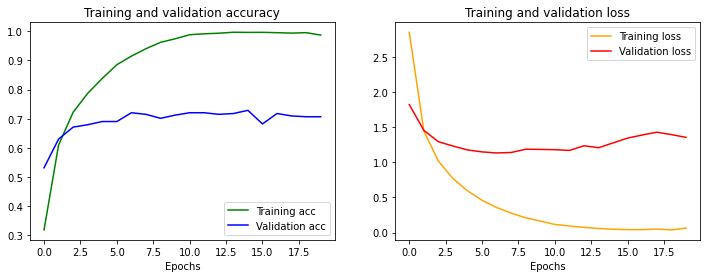

In [85]:
#Import relevant graphing packages
import matplotlib.pyplot as plt

plt.figure(figsize = (12, 4))
#Store the performance metrics from the model fit including loss and accuracy
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

#Define the x axis as the number of epochs
epochs = range(len(acc))

#Plot the accuracy of the training and validation tests
plt.subplot(1,2, 1)
plt.plot(epochs, acc, 'g', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.xlabel("Epochs")
plt.title('Training and validation accuracy')
plt.legend()



#Plot the loss of the training and validation tests
plt.subplot(1,2, 2)
plt.plot(epochs, loss, 'orange', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel("Epochs")
plt.title('Training and validation loss')
plt.legend()

plt.show()

### Model Evaluation 

* Examine your models (coefficients, parameters, errors, etc...)

* Compute and interpret your results in terms of accuracy, precision, recall, ROC etc. 

In [5]:
## Code is below

### Some Utility Functions

In [56]:
# Swap class_indices keys and values and create a new dictionary.
# This dictionary later will be used to get the class name of a prediction.
classes={}
for k in train_generator.class_indices.keys():
    classes[train_generator.class_indices[k]]=k
print(classes)

# Saving the name of each sport and its corresponding index and numpy. This disctionary will later be used in streamlit/
np.save("sport_names_dict",classes)

{0: 'air hockey', 1: 'ampute football', 2: 'archery', 3: 'arm wrestling', 4: 'balance beam', 5: 'barell racing', 6: 'baseball', 7: 'basketball', 8: 'billiards', 9: 'bmx', 10: 'bobsled', 11: 'bowling', 12: 'boxing', 13: 'bull riding', 14: 'canoe slamon', 15: 'cricket', 16: 'croquet', 17: 'curling', 18: 'fencing', 19: 'field hockey', 20: 'figure skating men', 21: 'figure skating pairs', 22: 'figure skating women', 23: 'football', 24: 'formula 1 racing', 25: 'frisbee', 26: 'giant slalom', 27: 'golf', 28: 'hammer throw', 29: 'harness racing', 30: 'high jump', 31: 'hockey', 32: 'horse jumping', 33: 'horse racing', 34: 'hurdles', 35: 'ice climbing', 36: 'jai alai', 37: 'javelin', 38: 'judo', 39: 'lacrosse', 40: 'luge', 41: 'motorcycle racing', 42: 'nascar racing', 43: 'olympic wrestling', 44: 'parallel bar', 45: 'pole vault', 46: 'polo', 47: 'pommel horse', 48: 'rings', 49: 'rock climbing', 50: 'rollerblade racing', 51: 'rowing', 52: 'rugby', 53: 'sailboat racing', 54: 'shot put', 55: 'ski j

In [57]:
# This function uses the deep learning model to predict the sport name. 
def predict_sport_type(model, img_path):
    img_path = img_path
    #An image is selected from our dataset last week using cats and dogs

    img = image.load_img(img_path, target_size=(150,150))
    #The image is resized to match the model

    x = image.img_to_array(img)
    #The image is converted to an array
    x = np.expand_dims(x, axis=0)
    #The shape of the array is expanded
    x = preprocess_input(x)
    #Preprocess the array
    x = model.predict(x)
    #The image class is predicted and given a probability for each of the three classes
    y = np.argmax(x, axis=-1)
    #The position of the highest probablity is specified

    print("This is an image of {}.".format(classes[np.argmax(x)]))

In [58]:
# Displays classification report of the model
def classification_report_gen(model_pred, dataset):
    #model_pred = prediction by the model
    #dataset = the dataset used in the model
    data_labels = dataset.classes

    predictions_rounded_labels = np.argmax(model_pred, axis=1)
    target_names = ['air hockey', 'ampute football', 'archery', 'arm wrestling', 'balance beam', 
                    'barell racing', 'baseball', 'basketball', 'billiards', 'bmx', 'bobsled', 'bowling', 'boxing', 
                    'bull riding', 'canoe slamon', 'cricket', 'croquet', 'curling', 'fencing', 'field hockey', 
                    'figure skating men', 'figure skating pairs', 'figure skating women', 'football', 
                    'formula 1 racing', 'frisbee', 'giant slalom', 'golf', 'hammer throw', 'harness racing', 
                    'high jump', 'hockey', 'horse jumping', 'horse racing', 'hurdles', 'ice climbing', 'jai alai',
                    'javelin', 'judo', 'lacrosse', 'luge', 'motorcycle racing', 'nascar racing', 
                    'olympic wrestling', 'parallel bar', 'pole vault', 'polo', 'pommel horse', 'rings', 
                    'rock climbing', 'rollerblade racing', 'rowing', 'rugby', 'sailboat racing', 'shot put', 
                    'ski jumping', 'skydiving', 'snow boarding', 'snowmobile racing', 'speed skating', 
                    'sumo wrestling', 'surfing', 'swimming', 'table tennis', 'tennis', 'track bicycle', 
                    'tug of war', 'uneven bars', 'volleyball', 'water polo', 'weightlifting', 
                    'wheelchair basketball', 'wheelchair racing']
    print(classification_report(data_labels, predictions_rounded_labels, target_names=target_names))
    
    
# This function plots confusion matrix resulting fromt the model.
def confusion_matrix_plotter(model_pred, dataset):
    
    target_names = np.array(list(classes.values()))
    model_pred = np.argmax(model_pred, axis=1)
    
    disp = ConfusionMatrixDisplay(confusion_matrix(dataset.classes, model_pred), display_labels=target_names)
    fig, ax = plt.subplots(figsize=(20,20))
    
    disp.plot(ax = ax)
    plt.xticks(rotation = 90)
    plt.show()

    
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    fig, c_ax = plt.subplots(1,1, figsize = (12, 8))
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)

    for (idx, c_label) in enumerate(test_generator.class_indices):
        fpr, tpr, thresholds = roc_curve(y_test[:,idx].astype(int), y_pred[:,idx])
        c_ax.plot(fpr, tpr, label = '%s (AUC:%0.2f)'  % (c_label, auc(fpr, tpr)))
        c_ax.legend()
    return roc_auc_score(y_test, y_pred, average=average)

# The following Function generates Non_augmented Image Data (train, test, validation)
def data_generator(data_directory, batch_size, target_size = (150, 150)):
    
    data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0)

    output_generator = data_gen.flow_from_directory(
        train_dir, 
        class_mode='categorical', 
        batch_size = batch_size, 
        target_size = target_size,
        shuffle = False)
    return output_generator

# Missclassified images plot
def misclassified_images_plot(y_pred, dataset):
    #y_pred = array of prediction result from the model
    #dataset = dataset used in the model (this should be data_generator)
    y_pred = np.argmax(y_pred, axis=1)

    paths = test_generator.filepaths
    errors = np.where(y_pred != test_generator.classes)[0]
    error_paths = [paths[i] for i in errors]


    images = [Image.open(x) for x in error_paths]

    fig = plt.figure(figsize=(30., 30.))
    grid = ImageGrid(fig, 111, nrows_ncols=(5, 5), axes_pad=0.8, share_all=True)

    for ax, im, file, pred, act in zip(grid, images, [os.path.basename(x) for x in error_paths],
                                       [labels[y_pred[i]] for i in errors],
                                       [labels[test_generator.classes[i]] for i in errors]):
        # Iterating over the grid returns the Axes.
        ax.imshow(im)
        ax.set_title(file + "\nPredicted: " + pred + " \nActual: " + act)

    plt.show()

##### VGG19

In [78]:
# Load the model
vgg_model = tf.keras.models.load_model("VGG19_Model/vgg_model.h5") 


19/19 [==============================] - 42s 2s/step - loss: 473.8303 - accuracy: 0.7644
                       precision    recall  f1-score   support

           air hockey       1.00      1.00      1.00         5
      ampute football       0.60      0.60      0.60         5
              archery       1.00      1.00      1.00         5
        arm wrestling       1.00      1.00      1.00         5
         balance beam       0.67      0.80      0.73         5
        barell racing       1.00      1.00      1.00         5
             baseball       0.50      0.20      0.29         5
           basketball       0.67      0.40      0.50         5
            billiards       1.00      1.00      1.00         5
                  bmx       1.00      0.20      0.33         5
              bobsled       1.00      0.80      0.89         5
              bowling       1.00      0.40      0.57         5
               boxing       1.00      0.80      0.89         5
          bull riding       

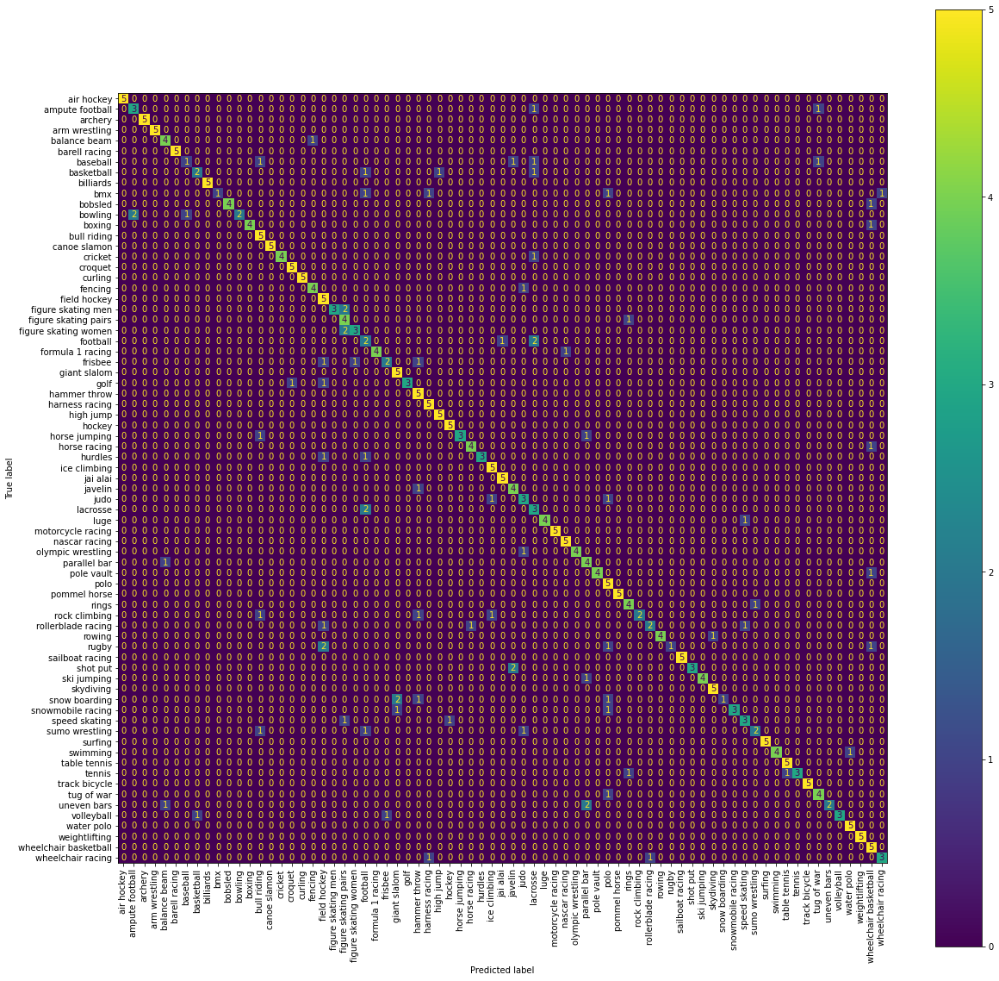

ROC AUC Score =  0.8805555555555555


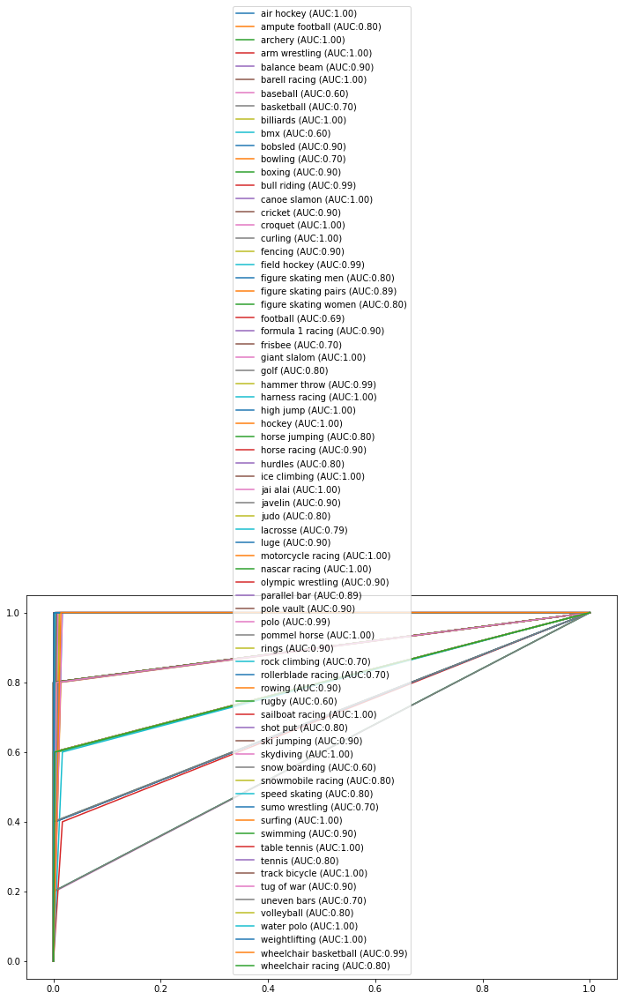

In [63]:
# Evaluation on Testing Dataset
test_result = vgg_model.evaluate(test_generator)

test_pred = vgg_model.predict(test_generator) 
# Classifiation Report on Testing Dataset
classification_report_gen(test_pred, test_generator)

#Confusion Matrix on Testing Dataset
confusion_matrix_plotter(test_pred, test_generator)

# ROC AUC Score
print("ROC AUC Score = ", multiclass_roc_auc_score(test_generator.classes, np.argmax(test_pred, axis=1)))



Found 10416 images belonging to 73 classes.
163/163 [==============================] - 813s 5s/step - loss: 68.4109 - accuracy: 0.9401
                       precision    recall  f1-score   support

           air hockey       1.00      0.96      0.98       112
      ampute football       1.00      0.98      0.99       112
              archery       0.99      0.98      0.99       132
        arm wrestling       1.00      0.99      0.99        99
         balance beam       0.83      0.99      0.91       152
        barell racing       1.00      0.97      0.98       123
             baseball       0.98      0.82      0.89       174
           basketball       0.95      0.92      0.93       169
            billiards       1.00      1.00      1.00       145
                  bmx       1.00      0.61      0.76       140
              bobsled       0.99      0.97      0.98       138
              bowling       1.00      0.92      0.96       120
               boxing       1.00      0.98   

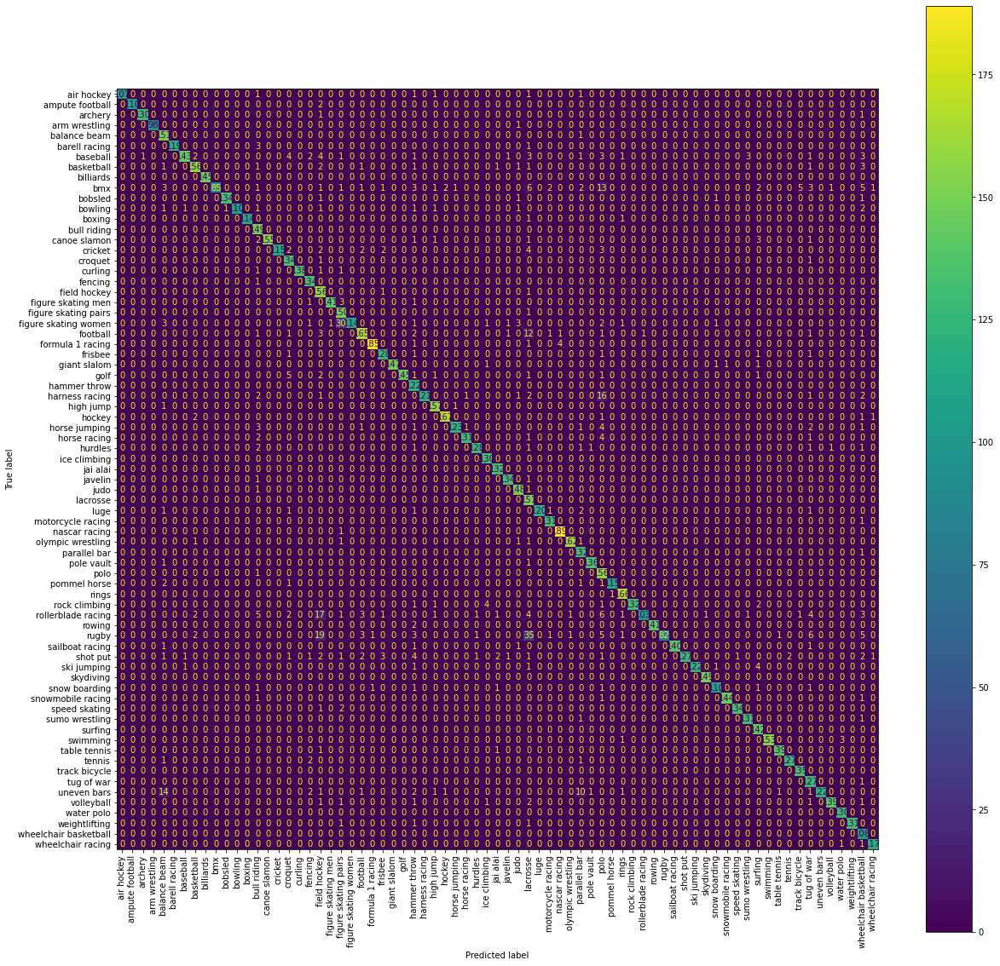

ROC AUC Score =  0.9712880739737298


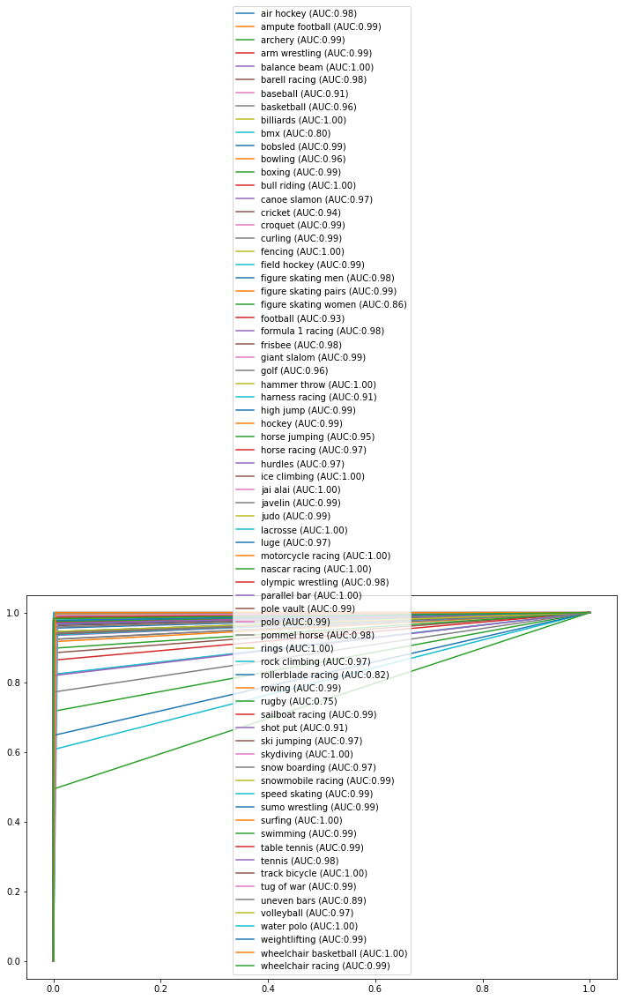

In [87]:
# Evaluation on Training Dataset
train_generator = data_generator(train_dir, batch_size = 64) #data_generator function defined above. Non augmented

train_result = vgg_model.evaluate(train_generator)

train_pred = vgg_model.predict(train_generator) 
# Classifiation Report on Training Dataset
classification_report_gen(train_pred, train_generator)

#Confusion Matrix on Training Dataset
confusion_matrix_plotter(train_pred, train_generator)

# ROC AUC Score
print("ROC AUC Score = ",multiclass_roc_auc_score(train_generator.classes, np.argmax(train_pred, axis=1)))



6/6 [==============================] - 30s 5s/step - loss: 505.1455 - accuracy: 0.7342
                       precision    recall  f1-score   support

           air hockey       1.00      0.80      0.89         5
      ampute football       0.83      1.00      0.91         5
              archery       0.83      1.00      0.91         5
        arm wrestling       1.00      1.00      1.00         5
         balance beam       0.67      0.80      0.73         5
        barell racing       0.80      0.80      0.80         5
             baseball       0.00      0.00      0.00         5
           basketball       0.80      0.80      0.80         5
            billiards       1.00      1.00      1.00         5
                  bmx       1.00      0.20      0.33         5
              bobsled       1.00      0.60      0.75         5
              bowling       1.00      0.20      0.33         5
               boxing       0.62      1.00      0.77         5
          bull riding       0.

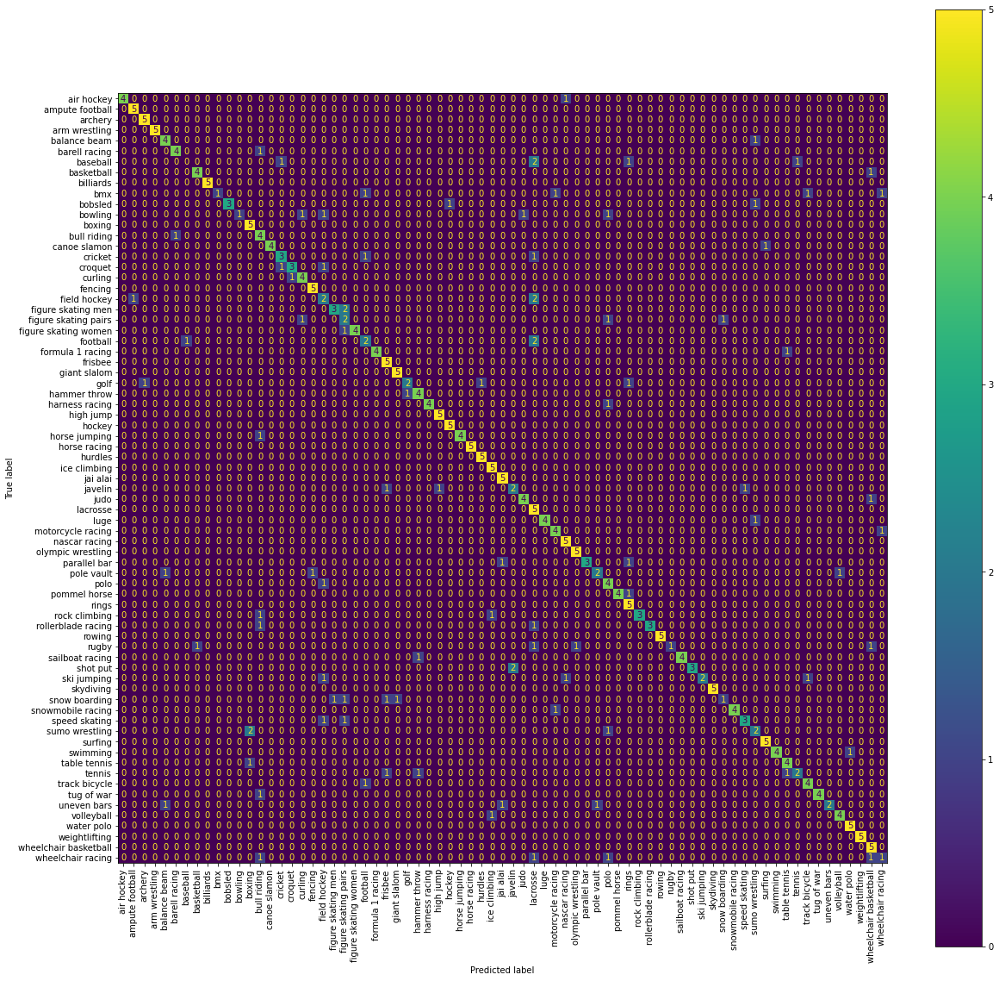

ROC AUC Score =  0.8652777777777777


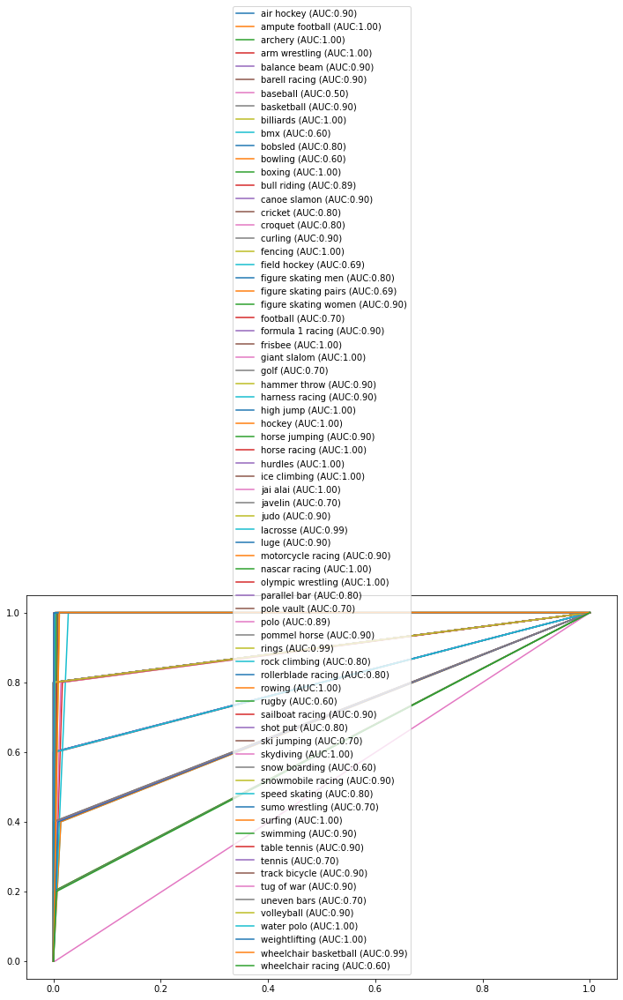

In [85]:
# Evaluation on Validation Dataset
train_result = vgg_model.evaluate(valid_generator) 

model_pred = vgg_model.predict(valid_generator) 
# Classifiation Report on Validation Dataset
classification_report_gen(model_pred, valid_generator)

#Confusion Matrix on Validation Dataset
confusion_matrix_plotter(model_pred, valid_generator)

# ROC AUC Score
print("ROC AUC Score = ", multiclass_roc_auc_score(valid_generator.classes, np.argmax(model_pred, axis=1)))

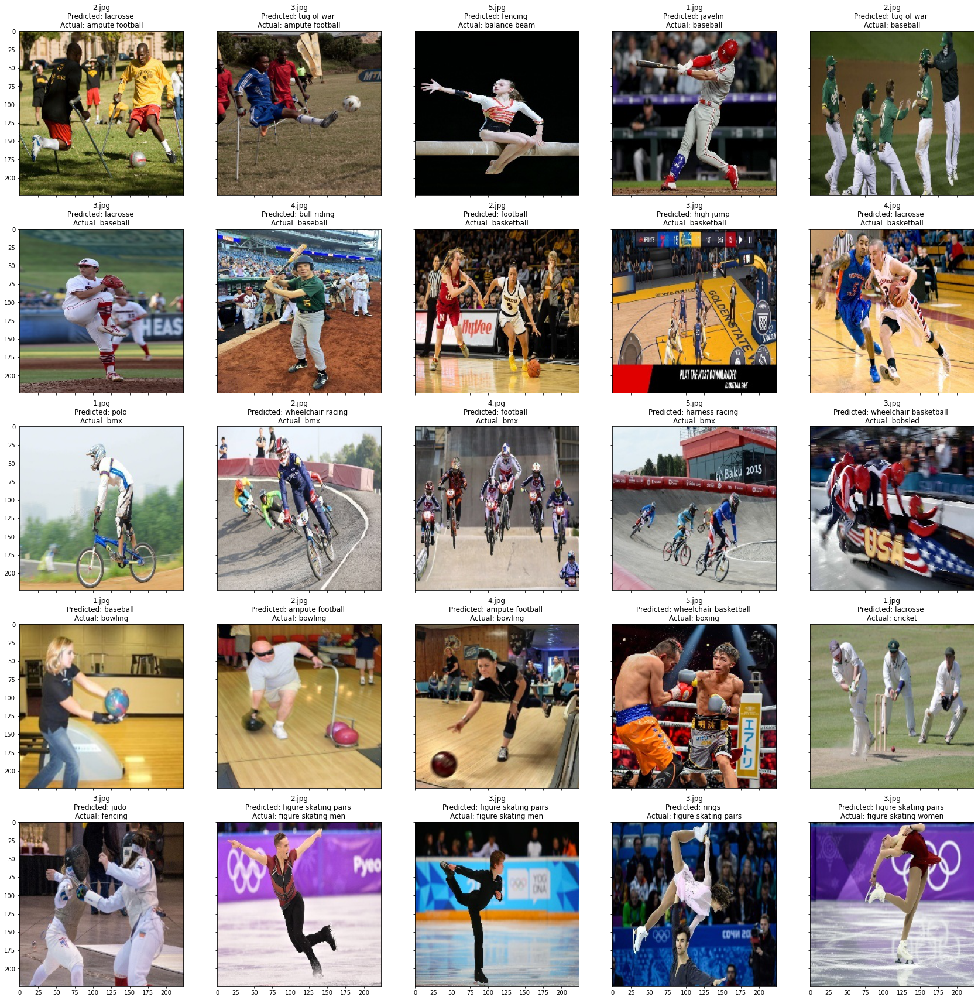

In [100]:
# Plotting misclassified images using predefined function
test_pred = vgg_model.predict(test_generator) 
misclassified_images_plot(test_pred, test_generator)

#####  Custom Model Start

In [66]:
# Load the model
custom_model = tf.keras.models.load_model("CustomModel/CNN_Custom_model.h5") 

Found 10416 images belonging to 73 classes.


In [89]:
# Evaluation on Training Dataset
train_generator = data_generator(train_dir, batch_size = 256) 

train_result = custom_model.evaluate(train_generator)

train_pred = custom_model.predict(train_generator) 
# Classifiation Report on Training Dataset
classification_report_gen(train_pred, train_generator)

#Confusion Matrix on Training Dataset
confusion_matrix_plotter(model_pred, train_generator)

# ROC AUC Score
print("ROC AUC Score = ",multiclass_roc_auc_score(train_generator.classes, np.argmax(train_pred, axis=1)))


Found 10416 images belonging to 73 classes.
163/163 [==============================] - 111s 681ms/step - loss: 0.8260 - accuracy: 0.7744
                       precision    recall  f1-score   support

           air hockey       0.81      0.80      0.81       112
      ampute football       0.77      0.76      0.76       112
              archery       0.75      0.71      0.73       132
        arm wrestling       0.90      0.93      0.92        99
         balance beam       0.88      0.80      0.83       152
        barell racing       0.85      0.82      0.83       123
             baseball       0.72      0.83      0.77       174
           basketball       0.79      0.65      0.71       169
            billiards       0.98      0.90      0.94       145
                  bmx       0.59      0.77      0.67       140
              bobsled       0.92      0.48      0.63       138
              bowling       0.98      0.38      0.54       120
               boxing       0.85      0.86 

ValueError: Found input variables with inconsistent numbers of samples: [10416, 365]

6/6 [==============================] - 7s 1s/step - loss: 1.2814 - accuracy: 0.6493


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.71      1.00      0.83         5
           1       0.60      0.60      0.60         5
           2       0.60      0.60      0.60         5
           3       0.67      0.40      0.50         5
           4       0.62      1.00      0.77         5
           5       1.00      0.80      0.89         5
           6       0.50      0.40      0.44         5
           7       0.25      0.20      0.22         5
           8       1.00      1.00      1.00         5
           9       0.43      0.60      0.50         5
          10       0.33      0.20      0.25         5
          11       0.00      0.00      0.00         5
          12       0.60      0.60      0.60         5
          13       0.50      0.80      0.62         5
          14       0.71      1.00      0.83         5
          15       0.83      1.00      0.91         5
          16       0.83      1.00      0.91         5
          17       1.00    

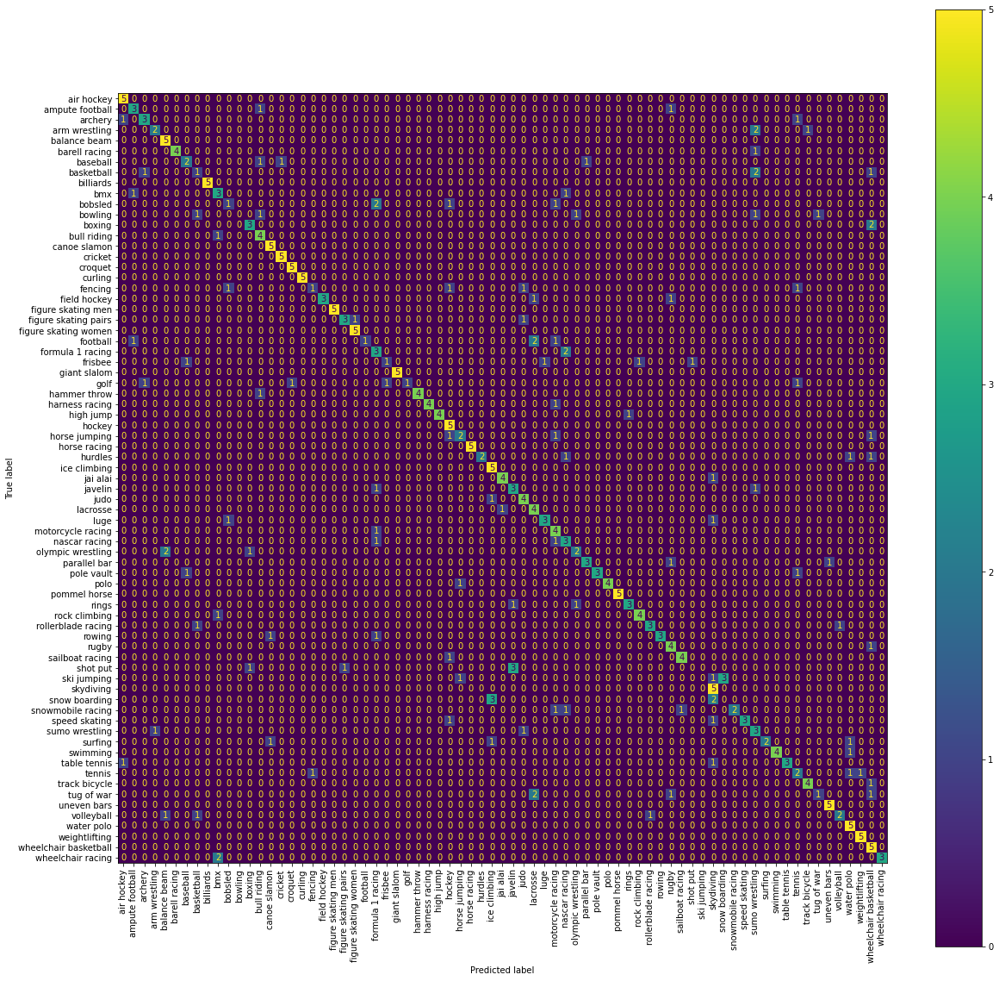

ROC AUC Score =  0.8222222222222222


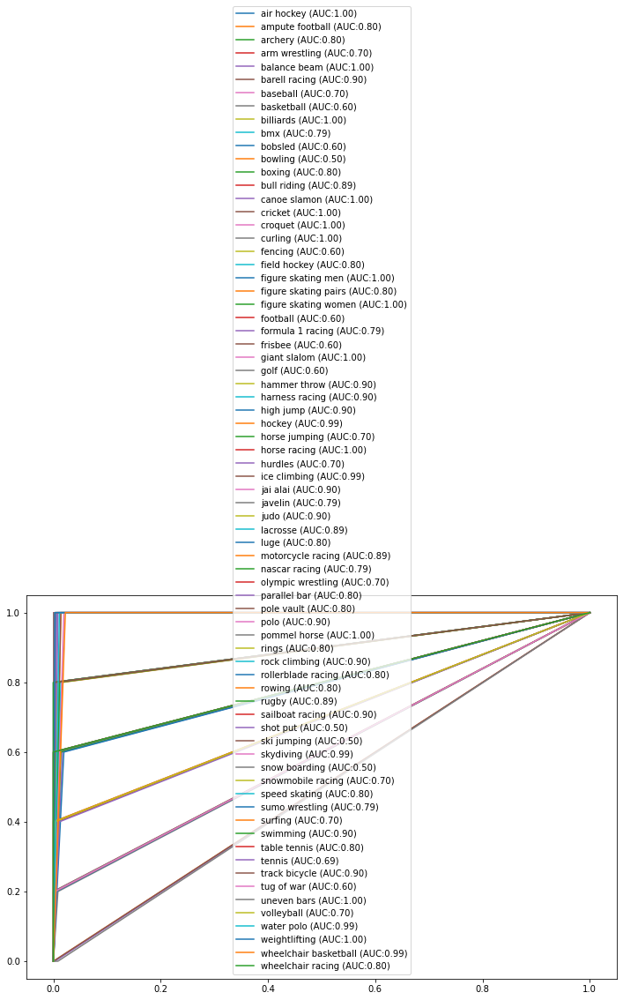

In [63]:
# Evaluation on Testing Dataset
test_result = custom_model.evaluate(test_generator)

model_pred = custom_model.predict(test_generator) 
# Classifiation Report on Testing Dataset
classification_report_gen(model_pred, test_generator)

#Confusion Matrix on Testing Dataset
confusion_matrix_plotter(model_pred, test_generator)

# ROC AUC Score
print("ROC AUC Score = ", multiclass_roc_auc_score(test_generator.classes, np.argmax(model_pred, axis=1)))




6/6 [==============================] - 6s 837ms/step - loss: 1.6466 - accuracy: 0.6000


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       1.00      0.80      0.89         5
           1       0.50      1.00      0.67         5
           2       1.00      0.40      0.57         5
           3       1.00      1.00      1.00         5
           4       1.00      0.60      0.75         5
           5       0.83      1.00      0.91         5
           6       0.57      0.80      0.67         5
           7       0.20      0.20      0.20         5
           8       1.00      1.00      1.00         5
           9       0.50      0.60      0.55         5
          10       1.00      0.60      0.75         5
          11       0.00      0.00      0.00         5
          12       0.50      1.00      0.67         5
          13       0.57      0.80      0.67         5
          14       0.33      0.40      0.36         5
          15       0.67      0.80      0.73         5
          16       0.75      0.60      0.67         5
          17       0.75    

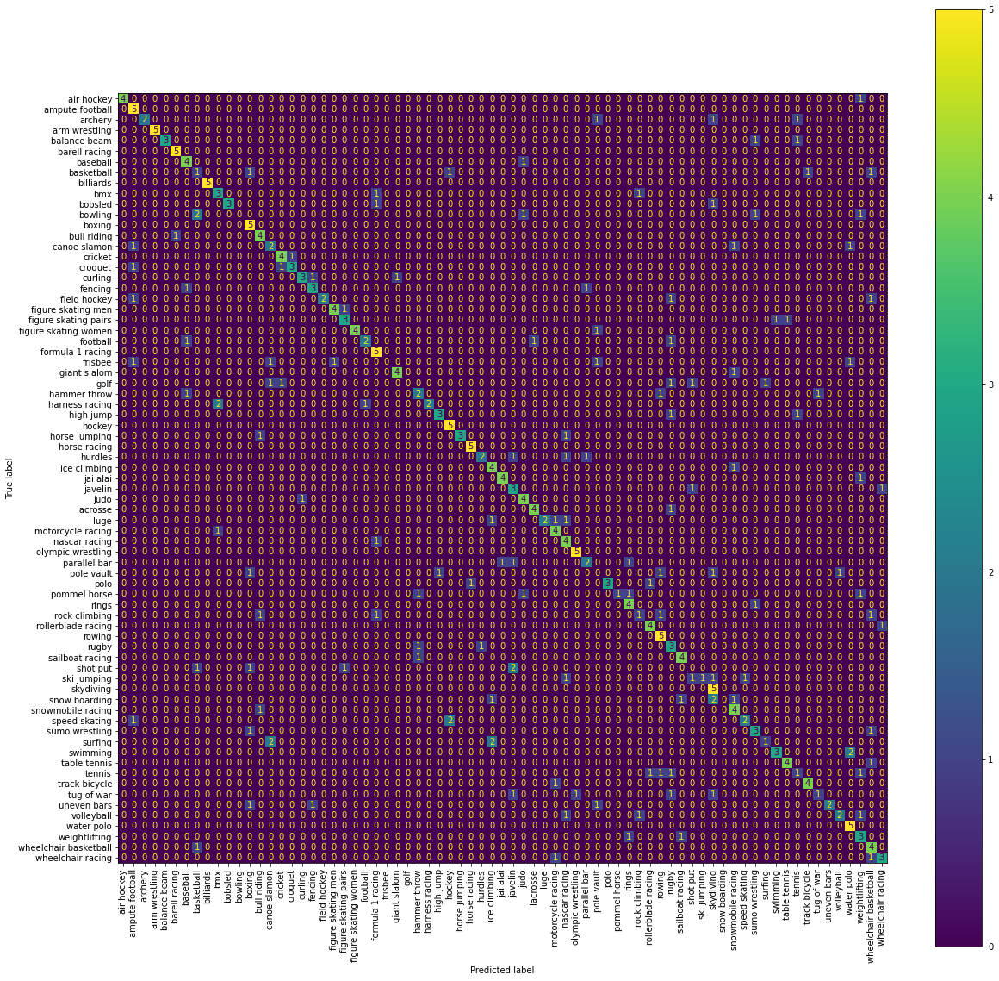

ROC AUC Score =  0.7972222222222223


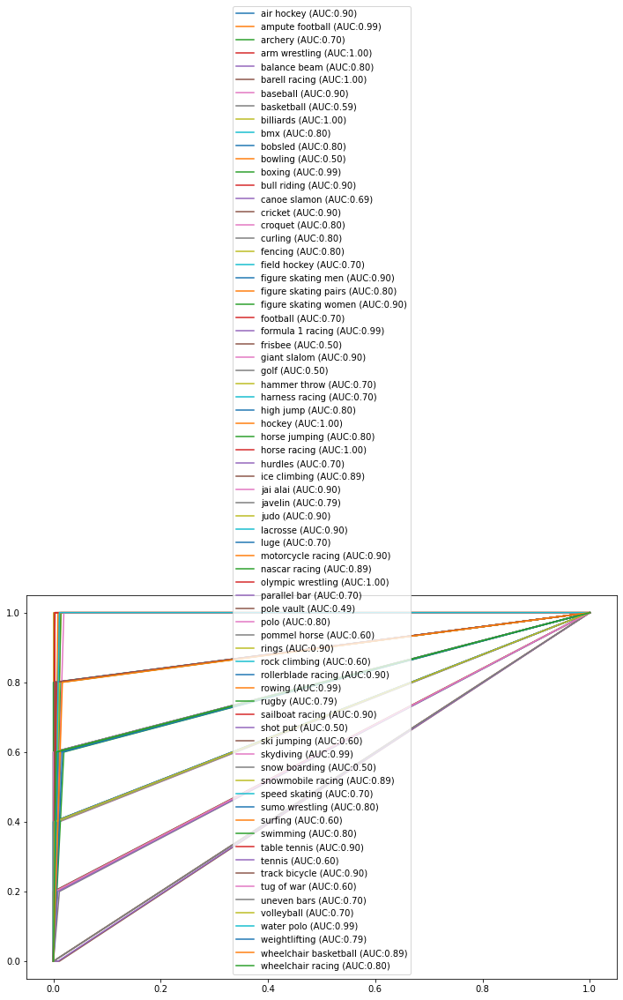

In [62]:
# Evaluation on Validation Dataset
train_result = custom_model.evaluate(valid_generator)

model_pred = custom_model.predict(valid_generator) 
# Classifiation Report on Validation Dataset
classification_report_gen(model_pred, valid_generator)

#Confusion Matrix on Validation Dataset
confusion_matrix_plotter(model_pred, valid_generator)

# ROC AUC Score
print("ROC AUC Score = ", multiclass_roc_auc_score(valid_generator.classes, np.argmax(model_pred, axis=1)))



In [ ]:
## Images 

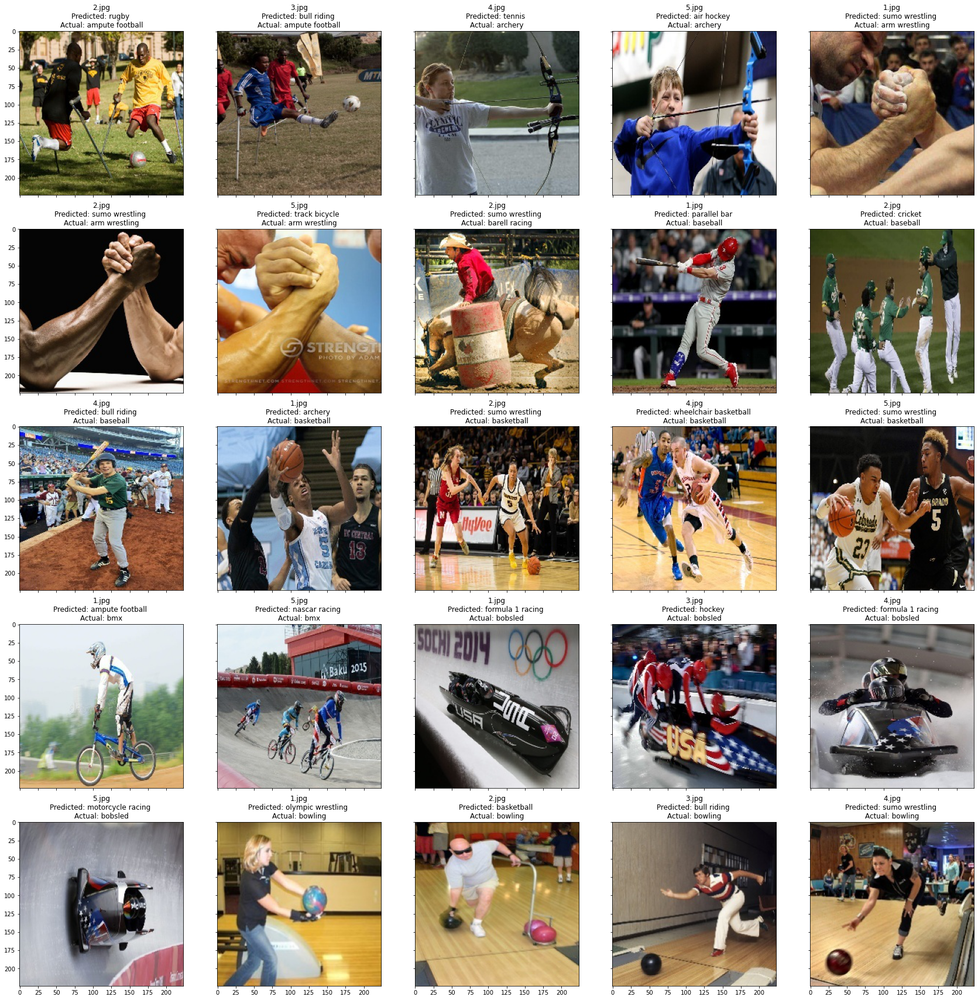

In [99]:
# Plotting misclassified images using predefined function
test_pred = custom_model.predict(test_generator) 
misclassified_images_plot(test_pred, test_generator)

##### MobileNetV2

In [106]:
#Loading the model
MobileNetV2 = tf.keras.models.load_model("MobileNet_Model/mobilenetv2.h5") 

In [66]:
# Evaluate on the test set for accuracy and loss
test_result = MobileNetV2.evaluate(test_generator)
print("Test loss:", test_result[0], " Test accuracy:", test_result[1])

19/19 [==============================] - 6s 268ms/step - loss: 0.6377 - categorical_accuracy: 0.8274 - categorical_crossentropy: 0.6377
Test loss: 0.6377414464950562  Test accuracy: 0.8273972868919373


assets            keras_metadata.pb variables
Found 10416 images belonging to 73 classes.
                       precision    recall  f1-score   support

           air hockey       0.69      0.70      0.69       112
      ampute football       0.74      0.92      0.82       112
              archery       0.83      0.86      0.84       132
        arm wrestling       0.98      0.94      0.96        99
         balance beam       0.78      0.68      0.73       152
        barell racing       0.87      0.89      0.88       123
             baseball       0.61      0.64      0.62       174
           basketball       0.72      0.53      0.61       169
            billiards       0.82      0.99      0.90       145
                  bmx       0.92      0.66      0.77       140
              bobsled       0.85      0.75      0.80       138
              bowling       0.90      0.79      0.84       120
               boxing       0.82      0.88      0.85       116
          bull riding      

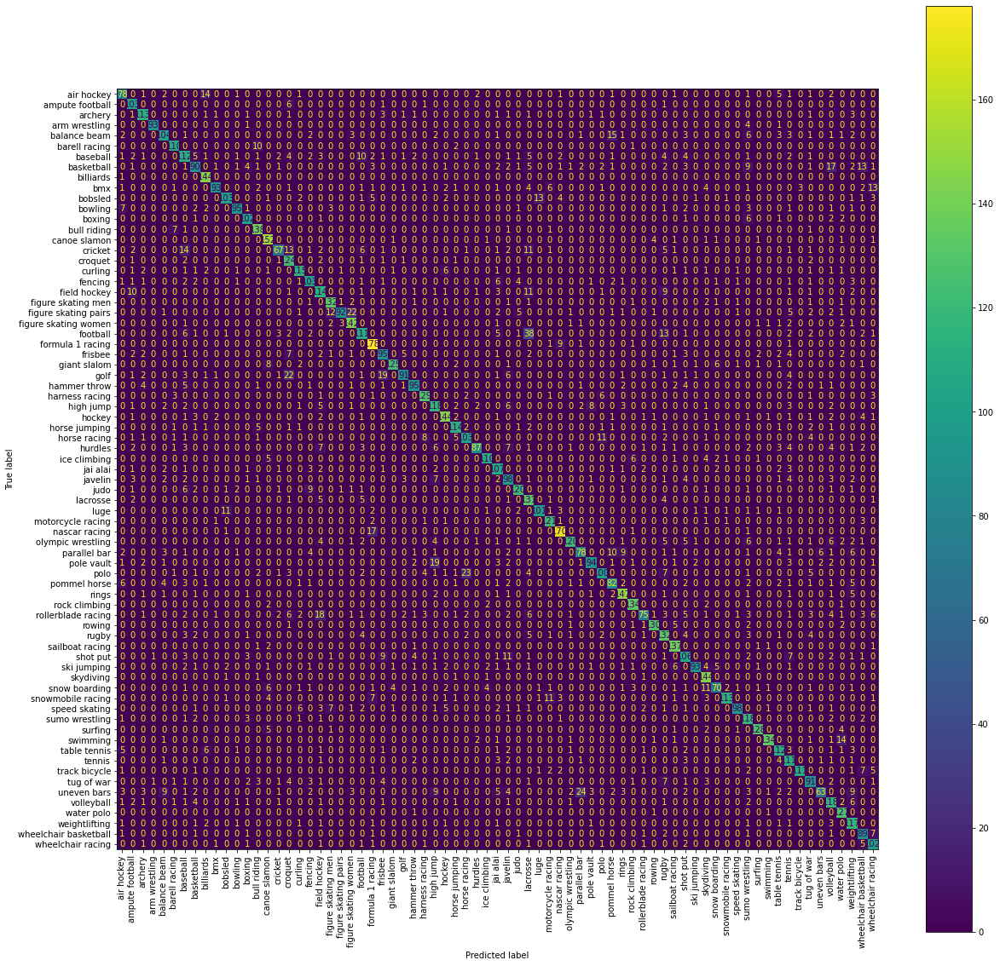

ROC AUC Score =  0.890506977066316


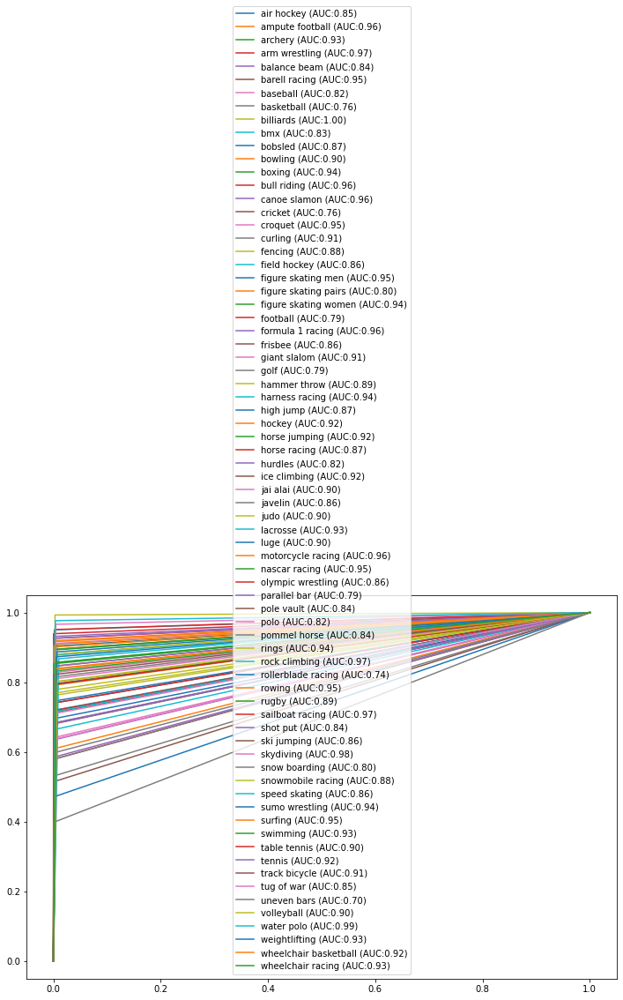

In [77]:
!ls ckpt_mobilenetv2  # Linux/MacOS

# Evaluation on Training Dataset
train_generator = data_generator(train_dir, batch_size = 20) #data_generator function defined above. Non augmented

#confusion matrices for evaluation of results
train_predictions =  MobileNetV2.predict(train_generator) 

# predefined classification function is used.
classification_report_gen(train_predictions, train_generator)

# Predefined confuction matrix function is used.
confusion_matrix_plotter(train_predictions, train_generator)

# ROC AUC Score
print("ROC AUC Score = ",multiclass_roc_auc_score(train_generator.classes, np.argmax(train_predictions, axis=1)))



                       precision    recall  f1-score   support

           air hockey       1.00      0.80      0.89         5
      ampute football       0.71      1.00      0.83         5
              archery       0.71      1.00      0.83         5
        arm wrestling       1.00      1.00      1.00         5
         balance beam       0.50      0.40      0.44         5
        barell racing       1.00      1.00      1.00         5
             baseball       0.75      0.60      0.67         5
           basketball       1.00      0.60      0.75         5
            billiards       0.83      1.00      0.91         5
                  bmx       0.67      0.40      0.50         5
              bobsled       0.80      0.80      0.80         5
              bowling       0.80      0.80      0.80         5
               boxing       0.83      1.00      0.91         5
          bull riding       1.00      0.80      0.89         5
         canoe slamon       0.71      1.00      0.83  

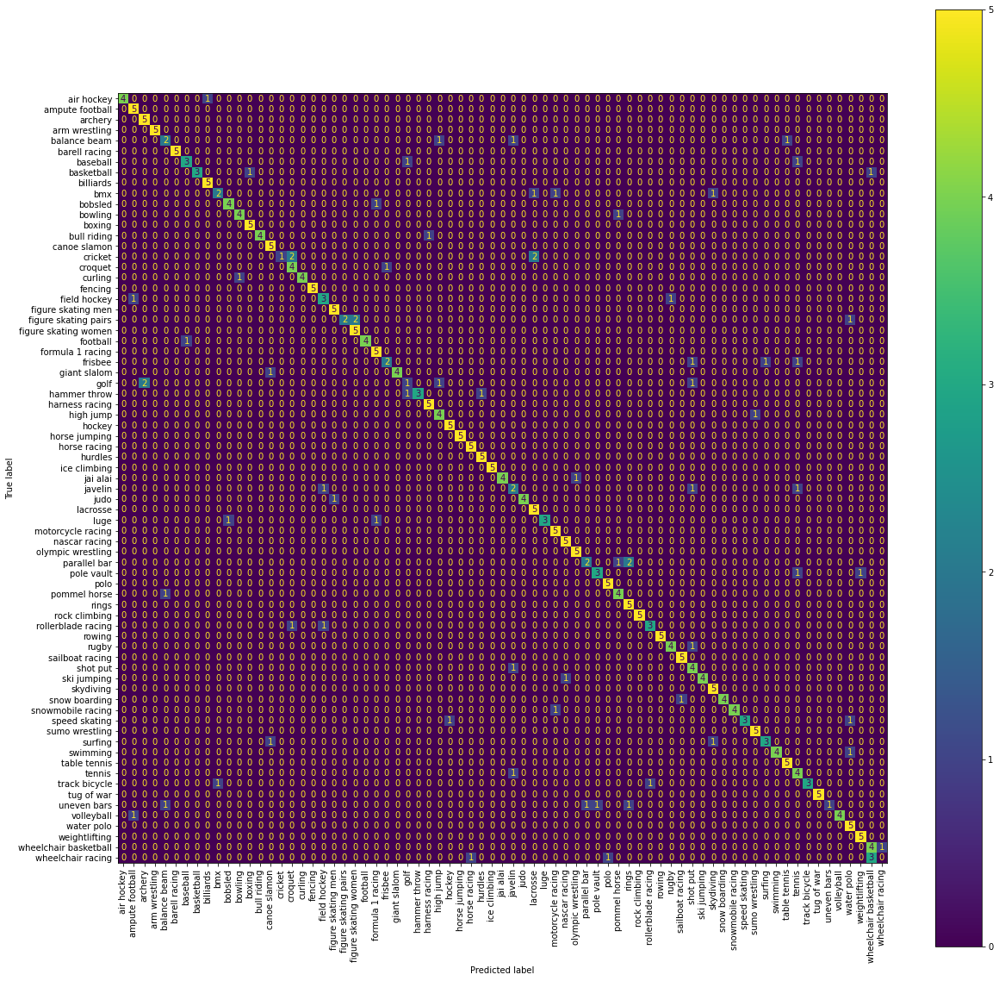

ROC AUC Score =  0.8944444444444445


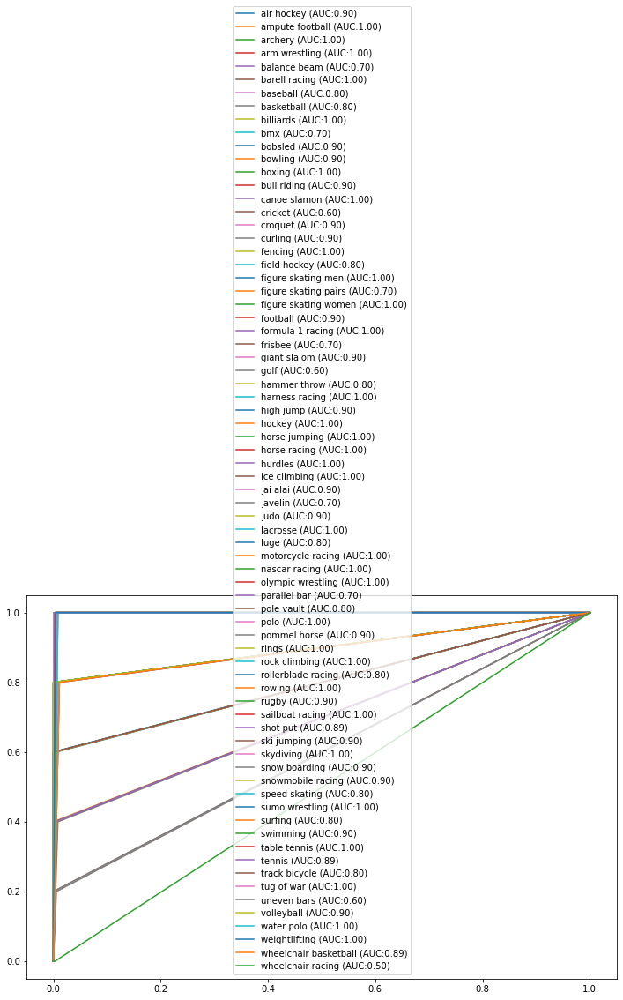

In [68]:
# Classification Report Validation Set
predictions = MobileNetV2.predict(valid_generator)

# predefined classification function is used.
classification_report_gen(predictions, valid_generator)

# Predefined confuction matrix function is used.
confusion_matrix_plotter(predictions, valid_generator)

# ROC AUC Score
print("ROC AUC Score = ", multiclass_roc_auc_score(valid_generator.classes, np.argmax(predictions, axis=1)))



                       precision    recall  f1-score   support

           air hockey       1.00      1.00      1.00         5
      ampute football       1.00      1.00      1.00         5
              archery       1.00      1.00      1.00         5
        arm wrestling       1.00      1.00      1.00         5
         balance beam       1.00      1.00      1.00         5
        barell racing       1.00      1.00      1.00         5
             baseball       0.60      0.60      0.60         5
           basketball       1.00      1.00      1.00         5
            billiards       1.00      1.00      1.00         5
                  bmx       1.00      0.60      0.75         5
              bobsled       0.75      0.60      0.67         5
              bowling       1.00      0.80      0.89         5
               boxing       1.00      1.00      1.00         5
          bull riding       1.00      1.00      1.00         5
         canoe slamon       1.00      1.00      1.00  

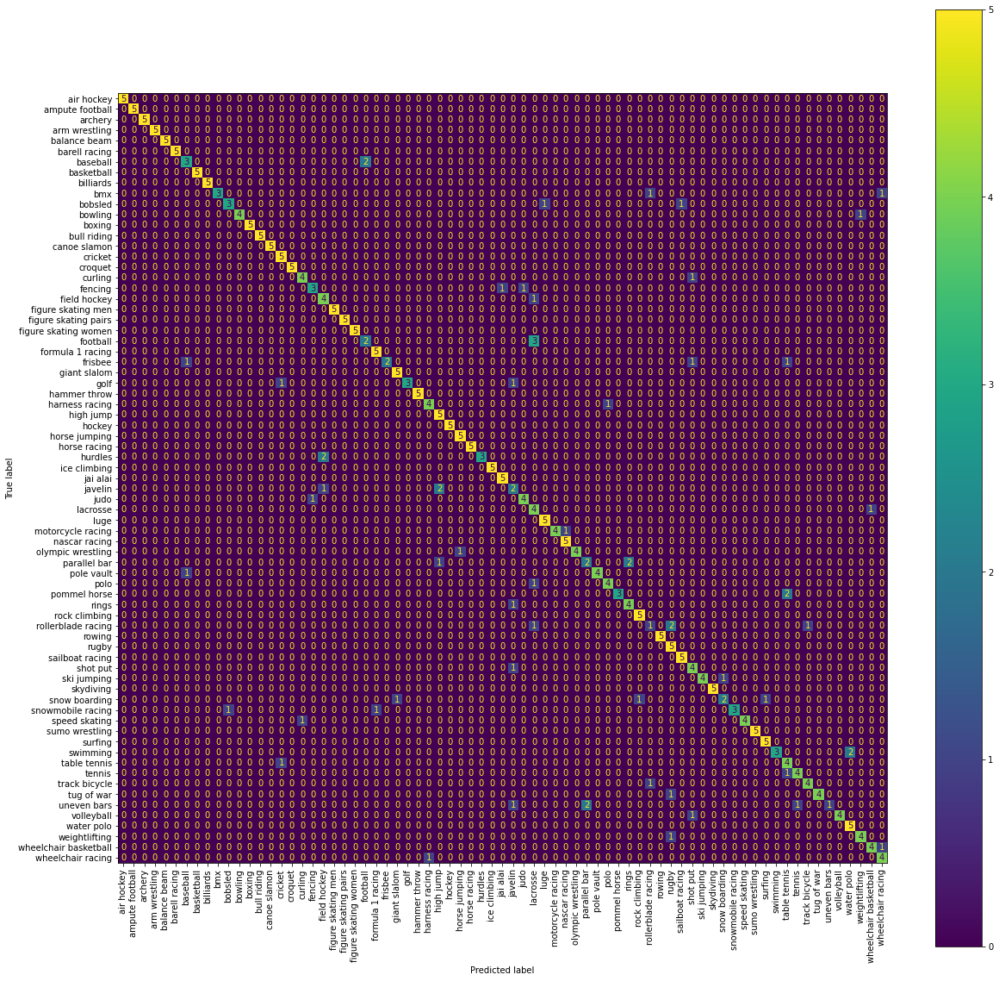

ROC AUC Score =  0.9125


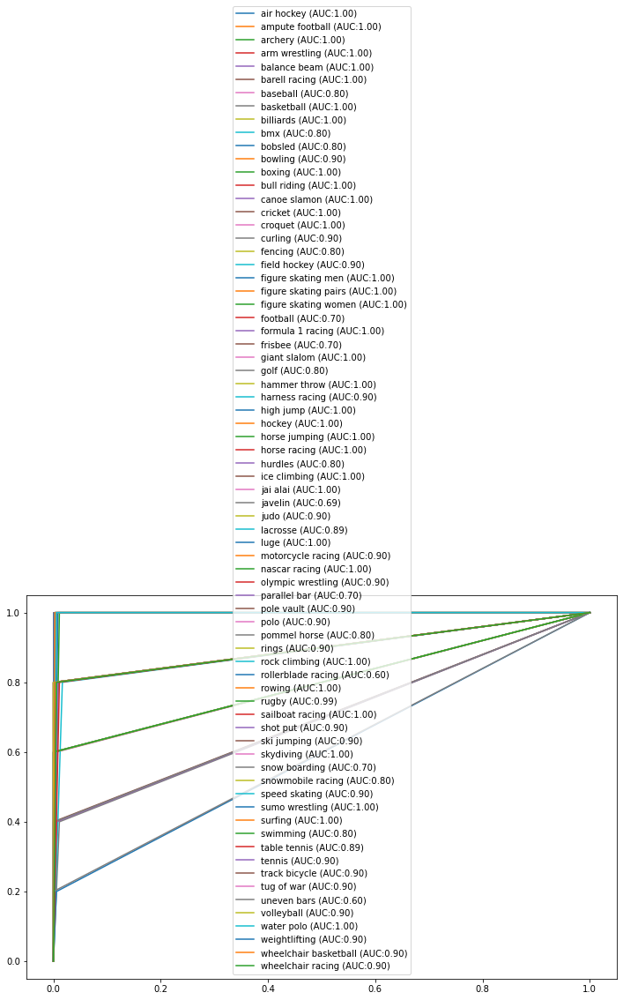

In [70]:
Y_pred = MobileNetV2.predict(test_generator)
# predefined classification function is used.

classification_report_gen(Y_pred, test_generator)

# Predefined confuction matrix function is used.
confusion_matrix_plotter(Y_pred, test_generator)

# ROC AUC Score
print("ROC AUC Score = ", multiclass_roc_auc_score(test_generator.classes, np.argmax(Y_pred, axis=1)))

In [72]:
# Getting the class and indices from the training dataset
labels={}
for k in test_generator.class_indices.keys():
    labels[test_generator.class_indices[k]]=k
    
# or labels = dict((v,k) for k,v in val_generator.class_indices.items())

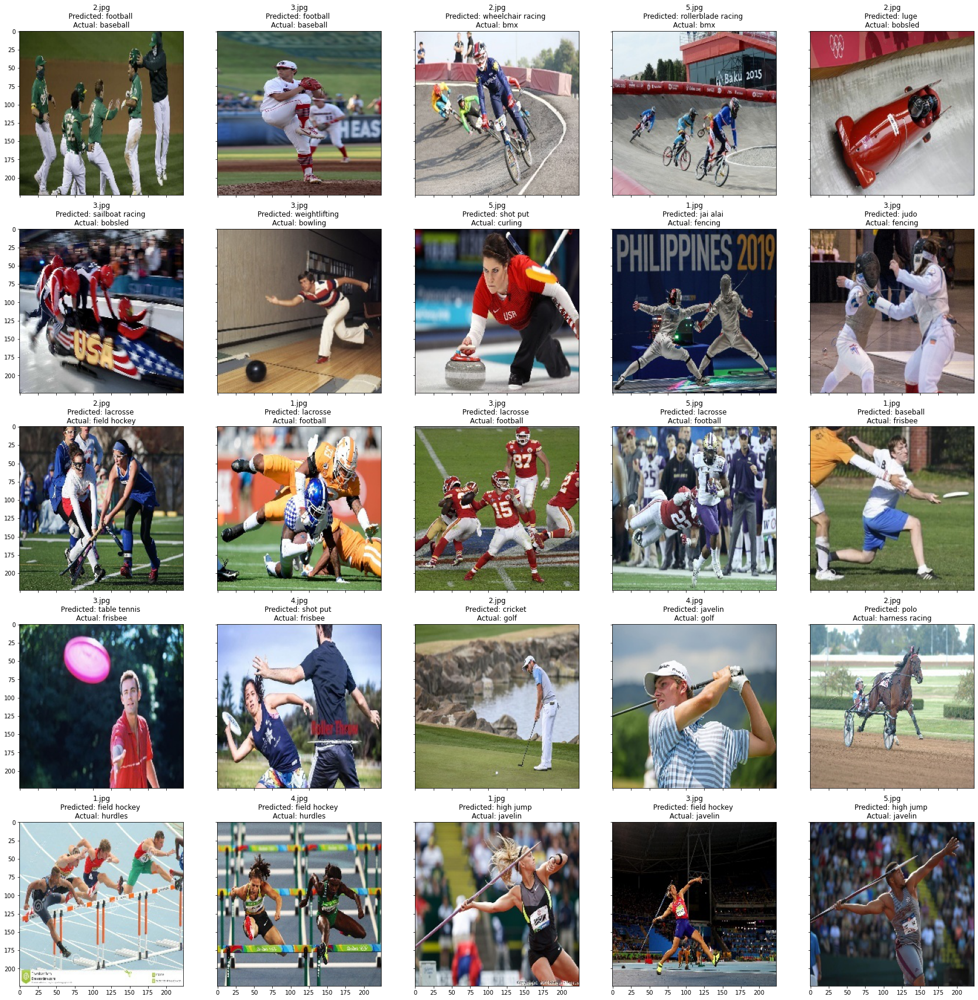

In [107]:
# Plotting misclassified images using predefined function

test_pred = MobileNetV2.predict(test_generator) 
misclassified_images_plot(test_pred, test_generator)

##### InceptionV3

In [104]:
#Loading the model
inceptionv3 = tf.keras.models.load_model("InceptionV3_Model/inceptionv3.h5") 


In [31]:
# Evaluate on the test set for accuracy and loss
test_result = inceptionv3.evaluate(test_generator)
print("Test loss:", test_result[0], " Test accuracy:", test_result[1])

6/6 [==============================] - 9s 1s/step - loss: 0.9320 - acc: 0.7616
Test loss: 0.9320015907287598  Test accuracy: 0.7616438269615173


Found 10416 images belonging to 73 classes.
                       precision    recall  f1-score   support

           air hockey       1.00      1.00      1.00       112
      ampute football       1.00      0.99      1.00       112
              archery       1.00      1.00      1.00       132
        arm wrestling       1.00      1.00      1.00        99
         balance beam       1.00      0.99      1.00       152
        barell racing       1.00      0.99      1.00       123
             baseball       0.97      1.00      0.99       174
           basketball       1.00      0.99      0.99       169
            billiards       1.00      1.00      1.00       145
                  bmx       0.97      1.00      0.99       140
              bobsled       1.00      1.00      1.00       138
              bowling       1.00      1.00      1.00       120
               boxing       1.00      1.00      1.00       116
          bull riding       1.00      1.00      1.00       149
         c

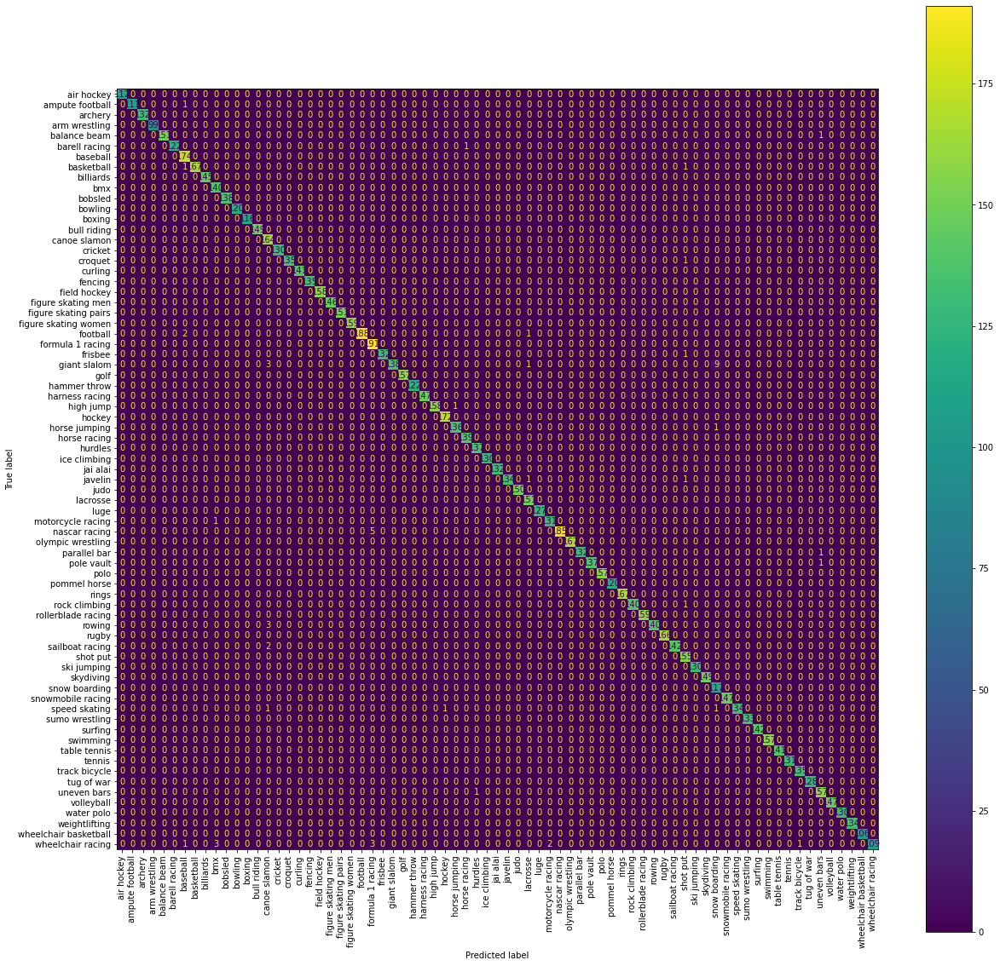

ROC AUC Score =  0.9973378491958841


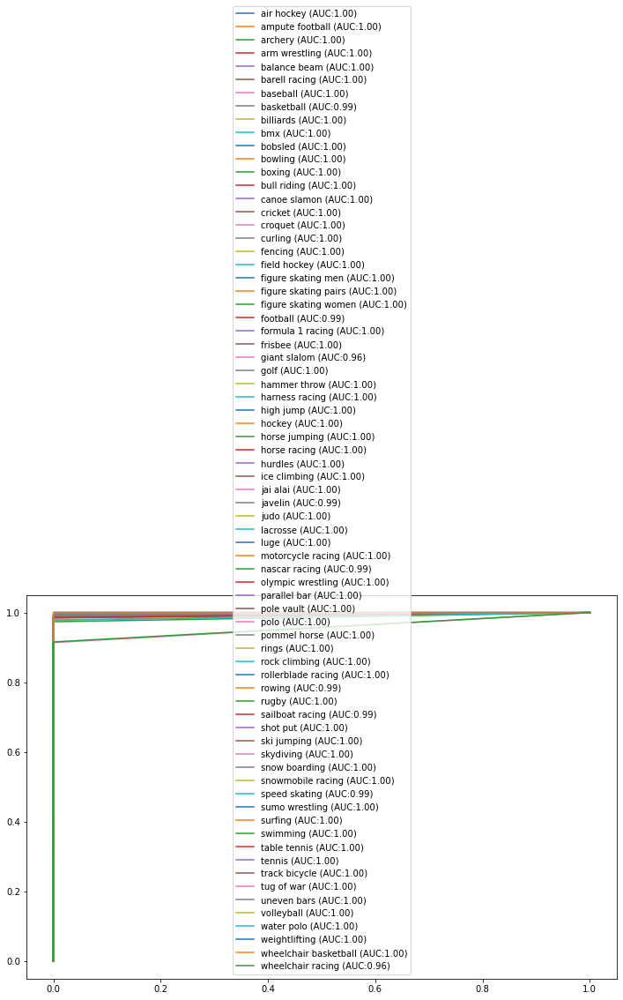

In [76]:
# Evaluation on Training Dataset
train_generator = data_generator(train_dir, batch_size = 64) #data_generator function defined above. Non augmented

#confusion matrices for evaluation of results
train_predictions =  inceptionv3.predict(train_generator) 

# predefined classification function is used.
classification_report_gen(train_predictions, train_generator)

# Predefined confuction matrix function is used.
confusion_matrix_plotter(train_predictions, train_generator)

# ROC AUC Score
print("ROC AUC Score = ",multiclass_roc_auc_score(train_generator.classes, np.argmax(train_predictions, axis=1)))

                       precision    recall  f1-score   support

           air hockey       1.00      0.80      0.89         5
      ampute football       1.00      0.60      0.75         5
              archery       0.67      0.40      0.50         5
        arm wrestling       0.83      1.00      0.91         5
         balance beam       0.67      0.80      0.73         5
        barell racing       1.00      0.60      0.75         5
             baseball       0.50      0.80      0.62         5
           basketball       1.00      0.80      0.89         5
            billiards       1.00      1.00      1.00         5
                  bmx       0.33      0.20      0.25         5
              bobsled       0.80      0.80      0.80         5
              bowling       1.00      0.60      0.75         5
               boxing       0.80      0.80      0.80         5
          bull riding       1.00      1.00      1.00         5
         canoe slamon       0.50      1.00      0.67  

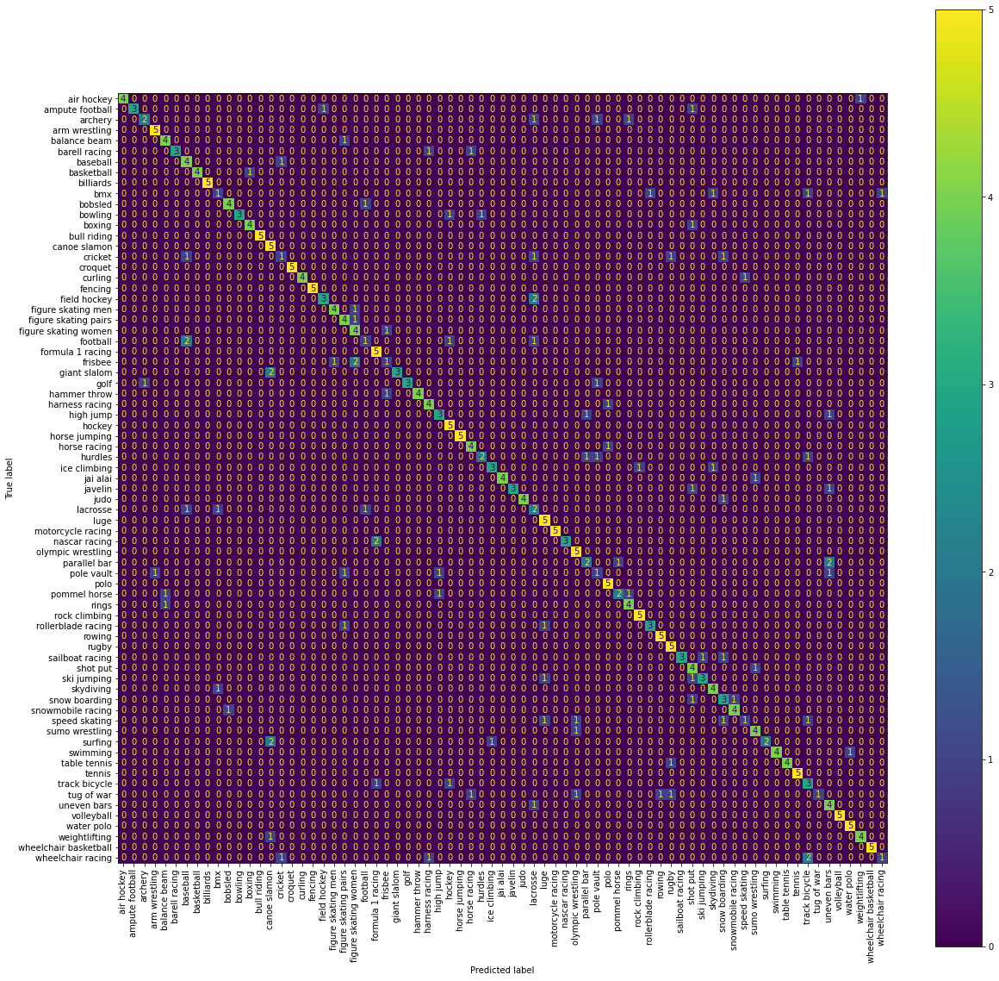

ROC AUC Score =  0.8555555555555555


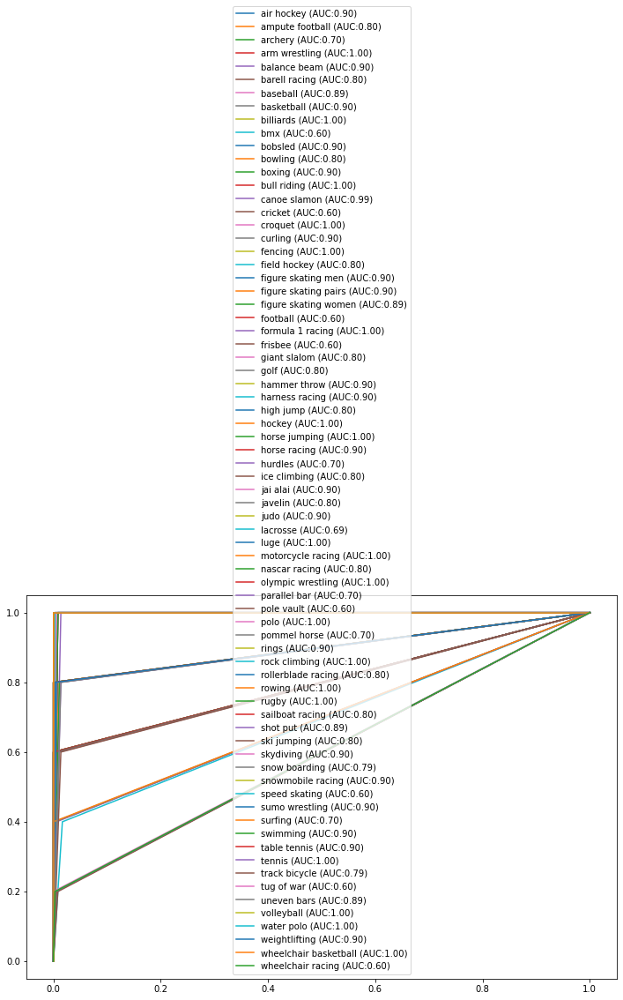

In [73]:
# Classification Report Validation Set
predictions = inceptionv3.predict(valid_generator)

# predefined classification function is used.
classification_report_gen(predictions, valid_generator)

# Predefined confuction matrix function is used.
confusion_matrix_plotter(predictions, valid_generator)

# ROC AUC Score
print("ROC AUC Score = ", multiclass_roc_auc_score(valid_generator.classes, np.argmax(predictions, axis=1)))

                       precision    recall  f1-score   support

           air hockey       1.00      0.80      0.89         5
      ampute football       0.60      0.60      0.60         5
              archery       0.83      1.00      0.91         5
        arm wrestling       1.00      1.00      1.00         5
         balance beam       0.80      0.80      0.80         5
        barell racing       1.00      1.00      1.00         5
             baseball       0.17      0.20      0.18         5
           basketball       0.75      0.60      0.67         5
            billiards       1.00      1.00      1.00         5
                  bmx       0.80      0.80      0.80         5
              bobsled       0.71      1.00      0.83         5
              bowling       1.00      0.60      0.75         5
               boxing       1.00      0.60      0.75         5
          bull riding       0.80      0.80      0.80         5
         canoe slamon       0.62      1.00      0.77  

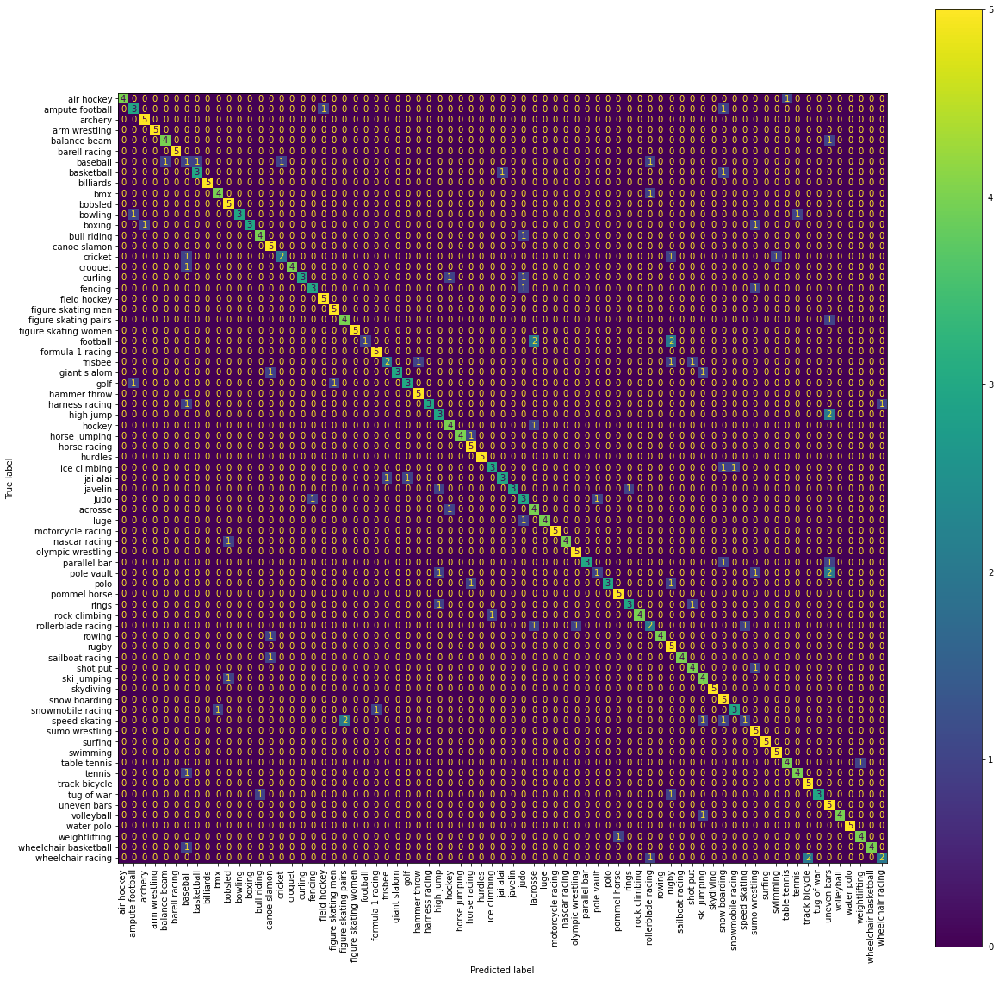

ROC AUC Score =  0.8791666666666665


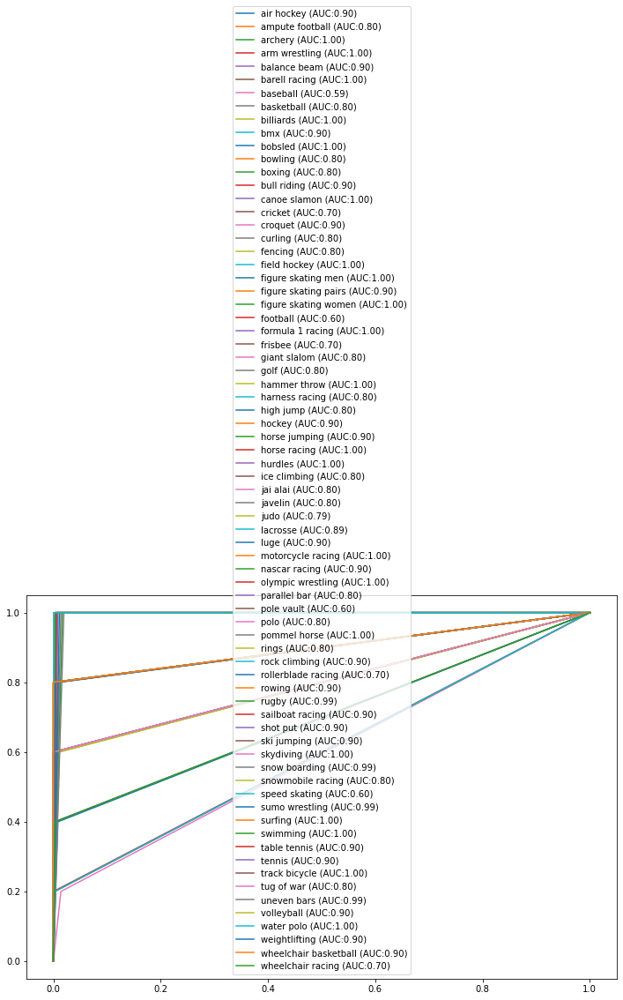

In [74]:
Y_pred = inceptionv3.predict(test_generator )
# predefined classification function is used.

classification_report_gen(Y_pred, test_generator)

# Predefined confuction matrix function is used.
confusion_matrix_plotter(Y_pred, test_generator)

# ROC AUC Score
print("ROC AUC Score = ", multiclass_roc_auc_score(test_generator.classes, np.argmax(Y_pred, axis=1)))

In [92]:
# Getting the class and indices from the training dataset
labels={}
for k in test_generator.class_indices.keys():
    labels[test_generator.class_indices[k]]=k
    
# or labels = dict((v,k) for k,v in val_generator.class_indices.items())

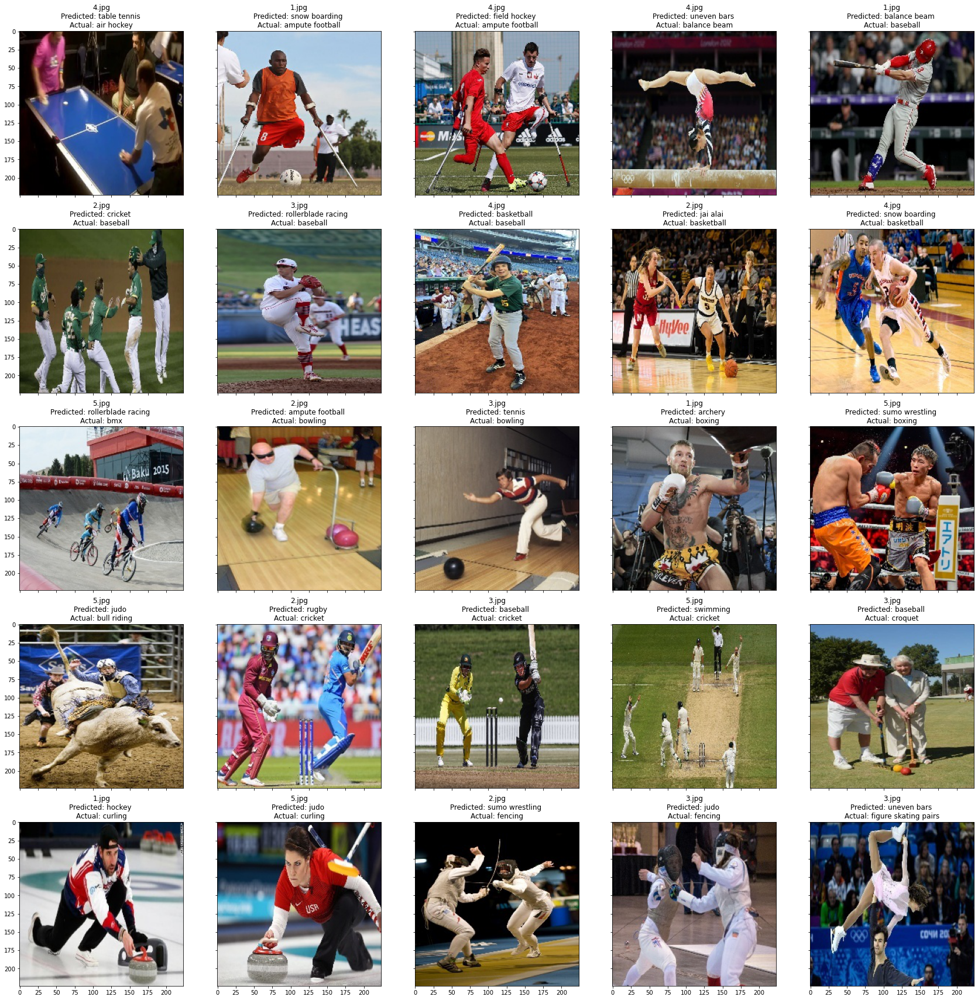

In [101]:
# Plotting misclassified images using predefined function
test_pred = inceptionv3.predict(test_generator) 
misclassified_images_plot(test_pred, test_generator)

### Issues / Improvements

1. Image classification issues persisted across the models in sports like football and baseball. 


2. Images per class are very small at about 50-200 images. This makes transfer learning difficult on such a small training set. We also used a pre selected 96.5/3.5 split of data and this could have be adjusted to get more concrete test and validation results.


3. Results could potentially be improved by setting an image per class cap and augmenting images so that each class is balanced.


4. The custom model gave superior speed but it did not reach the performance level of the other models.



###  References
   - Academic

These two papers were reviewed during our Scientific research paper and influenced our use of transfer learning and data augmentation.

Han, D., Liu, Q., & Fan, W. (2018). A new image classification method using CNN transfer learning and web data augmentation. Expert Systems with Applications, 95, 43–56. https://doi.org/10.1016/j.eswa.2017.11.028 

Xue, D., Zhou, X., Li, C., Yao, Y., Rahaman, M. M., Zhang, J., Chen, H., Zhang, J., Qi, S., & Sun, H. (2020). An application of transfer learning and Ensemble Learning techniques for cervical histopathology image classification. IEEE Access, 8, 104603–104618. https://doi.org/10.1109/access.2020.2999816  

   - Online
   
https://keras.io/api/preprocessing/image/ - Used to review how to create train/validation splits with the Keras ImageGenerator package

https://machinelearningmastery.com/how-to-use-transfer-learning-when-developing-convolutional-neural-network-models/ - Used for background knowledge on developing models with transfer learning and CNNs

https://keras.io/guides/transfer_learning/ - Used to review how to implement transfer learning with one of the Keras pre-trained models 

https://keras.io/api/applications/  - Used to provide detailed information regarding the transfer learning models including size and call names

	

### Credits

Throughout the code we utilize code provided in the Assignment 1-2 solutions, Practice Lessons and Keras Tutorials provided with each lesson. 

While we did not physically reusing any existing code from the creator of the dataset, the dataset is considered clean in that it does not contain duplicates, bad images and all the images are the same size and format. Additionally, the creator of the dataset split them into train and test datasets and provided labels for all of the images. We used the train and test datasets provided by the creator as they contain within them each sport labeled folder of data and an appropriate split of the data at 96.5/3.5. 

We also utilize the following transfer learning models which contain code created by other authors. Those models can be referenced here:

1.	VGG19 - https://keras.io/api/applications/vgg/#vgg19-function
2.	InceptionV3 - https://keras.io/api/applications/inceptionv3/
3.	MobileNetV2 - https://keras.io/api/applications/mobilenet/#mobilenetv2-function 

As noted in the Assingment 2 solutions:

Code of the Classifcation REport was adopted from
https://gist.github.com/RyanAkilos/3808c17f79e77c4117de35aa68447045

Code to convert one-hot encoded vectors to single-digits
https://stackoverflow.com/questions/54589669/confusion-matrix-error-classification-metrics-cant-handle-a-mix-of-multilabel

Code for the Misclassified Image Chart
https://matplotlib.org/stable/gallery/axes_grid1/simple_axesgrid.html![image-5.png](attachment:image-5.png)


In [ ]:
# End of Project